# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [14]:
#data_dir = './data'
#
# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

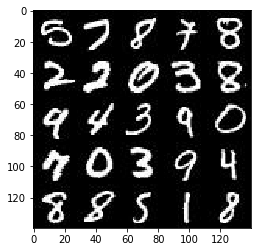

In [15]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

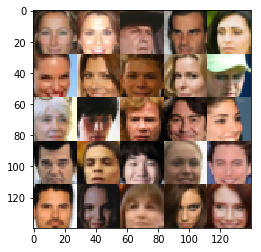

In [16]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [48]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [49]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learn_rate = tf.placeholder(tf.float32, (None), name='learn_rate')


    return inputs_real, inputs_z, learn_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [50]:
def discriminator(images, reuse=False):
    alpha = 0.2
    drop_rate = 0.75
    with tf.variable_scope('discriminator', reuse=reuse):
        images1 = tf.layers.dropout(images, rate=drop_rate/2.5)
        
        images1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        relu1 = tf.maximum(alpha * images1, images1)
        relu1 = tf.layers.dropout(relu1, rate=drop_rate)

        
        images2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        bn2 = tf.layers.batch_normalization(images2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        images3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        bn3 = tf.layers.batch_normalization(images3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        relu3 = tf.layers.dropout(relu3, rate=drop_rate)

        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [51]:
def generator(z, out_channel_dim, is_train=True):
    alpha = 0.2
    reuse = not is_train
    with tf.variable_scope('generator', reuse=reuse):

        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 4, strides=1, padding='valid', kernel_initializer=tf.contrib.layers.xavier_initializer())
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 4, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        x3 = tf.layers.conv2d_transpose(x3, out_channel_dim, 4, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())        

        logits = x3        
        out = tf.tanh(logits)
        
        return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [52]:
def model_loss(input_real, input_z, out_channel_dim):
    smooth = 0.1
    _, d_logits_real = discriminator(input_real, reuse=False)
    fake = generator(input_z, out_channel_dim, is_train=True)
    d_logits_fake = discriminator(fake, reuse=True)

    d_loss_real = tf.reduce_mean(
                      tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, 
                                                              labels=tf.ones_like(d_logits_real) * (1 - smooth)))
    d_loss_fake = tf.reduce_mean(
                      tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, 
                                                              labels=tf.zeros_like(d_logits_fake)))
    d_loss = d_loss_real + d_loss_fake

    g_loss = tf.reduce_mean(
                 tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                         labels=tf.ones_like(d_logits_fake)))
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [53]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    all_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    
    g_update_ops = [var for var in all_update_ops if var.name.startswith('generator')]
    d_update_ops = [var for var in all_update_ops if var.name.startswith('discriminator')]

    with tf.control_dependencies(d_update_ops):
        d_train_opt = tf.train.AdamOptimizer(learning_rate,beta1=beta1).minimize(d_loss, var_list=d_vars)
    with tf.control_dependencies(g_update_ops):
        g_train_opt = tf.train.AdamOptimizer(learning_rate,beta1=beta1).minimize(g_loss, var_list=g_vars)
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [54]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [55]:
import time
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    inputs_real, inputs_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(inputs_real, inputs_z, data_shape[-1])
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    step = 0 
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                start_time = time.time()
                step = step+1
                batch_images = batch_images * 2
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                #print('batch_z shape=',batch_z.shape)
                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict={inputs_real: batch_images, inputs_z: batch_z, lr:learning_rate})
                _ = sess.run(g_train_opt, feed_dict={inputs_z: batch_z, lr:learning_rate})
                
                if step % 100 == 0:
                    train_loss_d = d_loss.eval({inputs_z:batch_z, inputs_real: batch_images})
                    train_loss_g = g_loss.eval({inputs_z:batch_z})
                    print("Epoch {}/{} Step {}...".format(epoch_i+1, epoch_count, step),
                      "Discriminator Loss: {:.4f}...".format(train_loss_d),
                      "Generator Loss: {:.4f}".format(train_loss_g),
                      "... Time spent={:.4f}".format(time.time() - start_time))    

                if step % 200 == 0:
                    show_generator_output(sess, 25, inputs_z, data_shape[3], data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2 Step 100... Discriminator Loss: 0.8653... Generator Loss: 1.3607 ... Time spent=0.1602
Epoch 1/2 Step 200... Discriminator Loss: 1.0698... Generator Loss: 0.8340 ... Time spent=0.0867


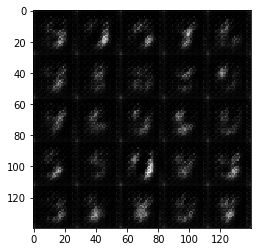

Epoch 1/2 Step 300... Discriminator Loss: 1.0773... Generator Loss: 0.8605 ... Time spent=0.0887
Epoch 1/2 Step 400... Discriminator Loss: 1.3202... Generator Loss: 0.5542 ... Time spent=0.0879


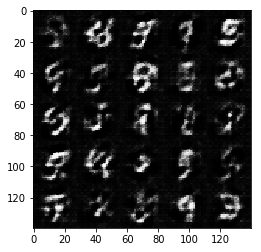

Epoch 1/2 Step 500... Discriminator Loss: 1.0924... Generator Loss: 0.7786 ... Time spent=0.0855
Epoch 1/2 Step 600... Discriminator Loss: 1.0934... Generator Loss: 0.7578 ... Time spent=0.0869


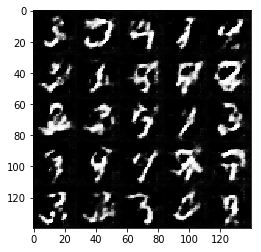

Epoch 1/2 Step 700... Discriminator Loss: 1.1630... Generator Loss: 0.6604 ... Time spent=0.0872
Epoch 1/2 Step 800... Discriminator Loss: 1.0193... Generator Loss: 1.2340 ... Time spent=0.0865


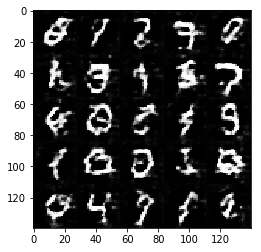

Epoch 1/2 Step 900... Discriminator Loss: 1.1489... Generator Loss: 0.9358 ... Time spent=0.0856
Epoch 1/2 Step 1000... Discriminator Loss: 1.1943... Generator Loss: 0.6951 ... Time spent=0.0865


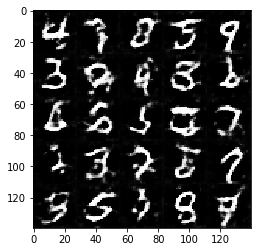

Epoch 1/2 Step 1100... Discriminator Loss: 1.3378... Generator Loss: 0.5085 ... Time spent=0.0859
Epoch 1/2 Step 1200... Discriminator Loss: 1.1103... Generator Loss: 1.0544 ... Time spent=0.0852


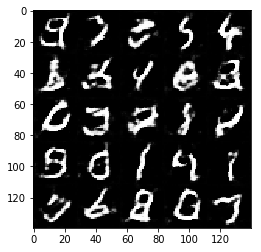

Epoch 1/2 Step 1300... Discriminator Loss: 0.9799... Generator Loss: 1.0896 ... Time spent=0.0890
Epoch 1/2 Step 1400... Discriminator Loss: 0.9086... Generator Loss: 1.1518 ... Time spent=0.0865


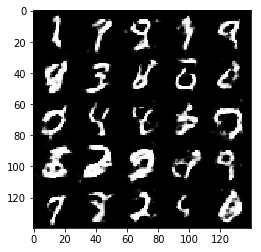

Epoch 1/2 Step 1500... Discriminator Loss: 1.0575... Generator Loss: 0.7821 ... Time spent=0.0918
Epoch 1/2 Step 1600... Discriminator Loss: 1.2158... Generator Loss: 0.6338 ... Time spent=0.0864


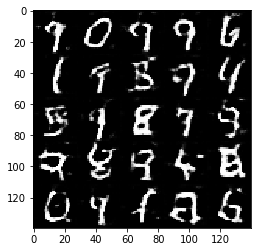

Epoch 1/2 Step 1700... Discriminator Loss: 1.2733... Generator Loss: 0.5653 ... Time spent=0.0871
Epoch 1/2 Step 1800... Discriminator Loss: 1.1097... Generator Loss: 0.8271 ... Time spent=0.0872


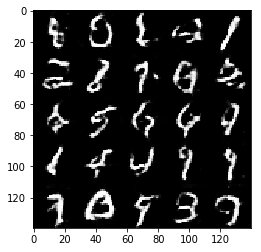

Epoch 2/2 Step 1900... Discriminator Loss: 1.7506... Generator Loss: 0.4108 ... Time spent=0.0870
Epoch 2/2 Step 2000... Discriminator Loss: 1.1186... Generator Loss: 0.7307 ... Time spent=0.0861


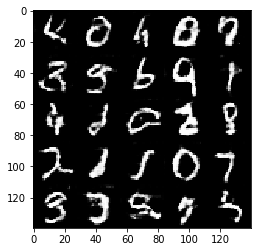

Epoch 2/2 Step 2100... Discriminator Loss: 0.9203... Generator Loss: 1.0475 ... Time spent=0.0866
Epoch 2/2 Step 2200... Discriminator Loss: 0.9642... Generator Loss: 1.2527 ... Time spent=0.0870


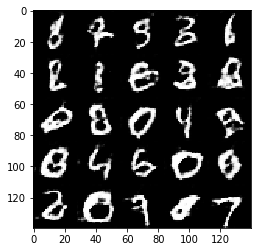

Epoch 2/2 Step 2300... Discriminator Loss: 1.4767... Generator Loss: 0.4362 ... Time spent=0.0858
Epoch 2/2 Step 2400... Discriminator Loss: 1.0565... Generator Loss: 0.7759 ... Time spent=0.0871


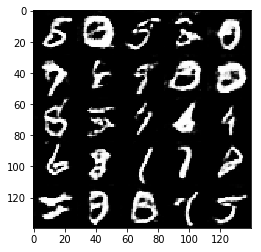

Epoch 2/2 Step 2500... Discriminator Loss: 0.9671... Generator Loss: 1.2414 ... Time spent=0.0863
Epoch 2/2 Step 2600... Discriminator Loss: 1.0753... Generator Loss: 0.7087 ... Time spent=0.0886


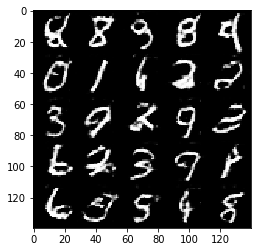

Epoch 2/2 Step 2700... Discriminator Loss: 1.2670... Generator Loss: 0.5842 ... Time spent=0.0870
Epoch 2/2 Step 2800... Discriminator Loss: 1.1327... Generator Loss: 0.6940 ... Time spent=0.0865


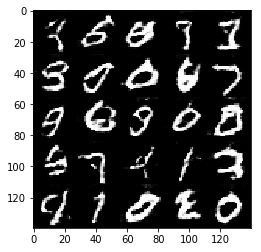

Epoch 2/2 Step 2900... Discriminator Loss: 1.5365... Generator Loss: 0.4419 ... Time spent=0.0870
Epoch 2/2 Step 3000... Discriminator Loss: 0.9593... Generator Loss: 0.9979 ... Time spent=0.0862


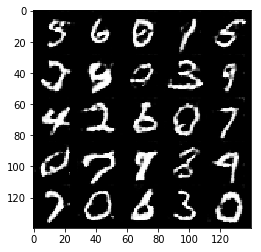

Epoch 2/2 Step 3100... Discriminator Loss: 1.2740... Generator Loss: 0.5811 ... Time spent=0.0863
Epoch 2/2 Step 3200... Discriminator Loss: 1.4128... Generator Loss: 1.7491 ... Time spent=0.0869


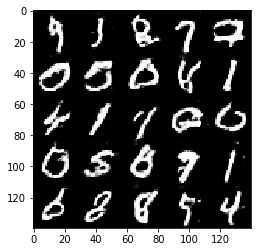

Epoch 2/2 Step 3300... Discriminator Loss: 0.9322... Generator Loss: 1.0072 ... Time spent=0.0863
Epoch 2/2 Step 3400... Discriminator Loss: 1.8187... Generator Loss: 1.8861 ... Time spent=0.0858


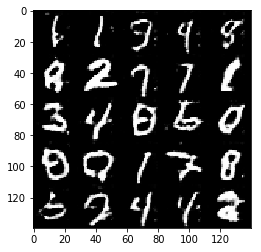

Epoch 2/2 Step 3500... Discriminator Loss: 0.9533... Generator Loss: 1.0277 ... Time spent=0.0890
Epoch 2/2 Step 3600... Discriminator Loss: 0.9670... Generator Loss: 0.8845 ... Time spent=0.0873


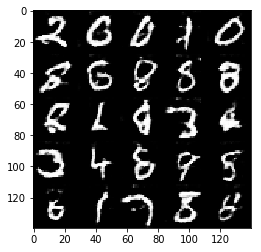

Epoch 2/2 Step 3700... Discriminator Loss: 0.9429... Generator Loss: 1.0252 ... Time spent=0.0858


In [56]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/10 Step 100... Discriminator Loss: 0.8348... Generator Loss: 1.5581 ... Time spent=0.1712
Epoch 1/10 Step 200... Discriminator Loss: 0.7525... Generator Loss: 1.7593 ... Time spent=0.0894


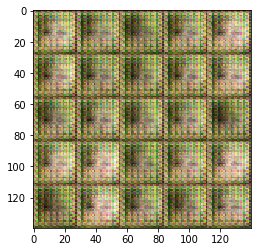

Epoch 1/10 Step 300... Discriminator Loss: 0.9886... Generator Loss: 1.8789 ... Time spent=0.0889
Epoch 1/10 Step 400... Discriminator Loss: 0.8124... Generator Loss: 1.8763 ... Time spent=0.0904


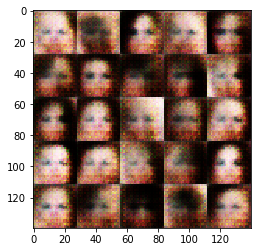

Epoch 1/10 Step 500... Discriminator Loss: 1.1331... Generator Loss: 0.7438 ... Time spent=0.0895
Epoch 1/10 Step 600... Discriminator Loss: 1.4244... Generator Loss: 0.8251 ... Time spent=0.0912


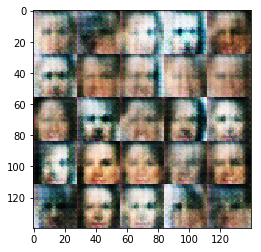

Epoch 1/10 Step 700... Discriminator Loss: 1.2289... Generator Loss: 1.0623 ... Time spent=0.0881
Epoch 1/10 Step 800... Discriminator Loss: 1.2540... Generator Loss: 0.6902 ... Time spent=0.0876


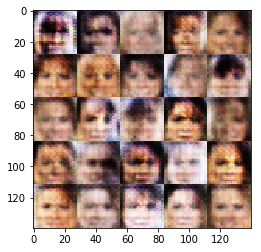

Epoch 1/10 Step 900... Discriminator Loss: 1.2779... Generator Loss: 0.7576 ... Time spent=0.0875
Epoch 1/10 Step 1000... Discriminator Loss: 1.3785... Generator Loss: 0.5340 ... Time spent=0.0881


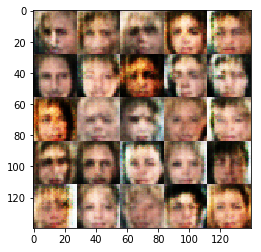

Epoch 1/10 Step 1100... Discriminator Loss: 1.2623... Generator Loss: 0.5960 ... Time spent=0.0889
Epoch 1/10 Step 1200... Discriminator Loss: 1.3007... Generator Loss: 0.8176 ... Time spent=0.0898


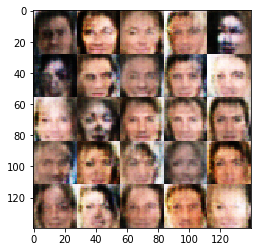

Epoch 1/10 Step 1300... Discriminator Loss: 1.3050... Generator Loss: 0.6439 ... Time spent=0.0904
Epoch 1/10 Step 1400... Discriminator Loss: 1.3131... Generator Loss: 0.6150 ... Time spent=0.0897


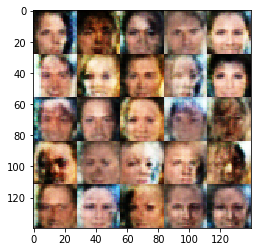

Epoch 1/10 Step 1500... Discriminator Loss: 1.1182... Generator Loss: 0.8550 ... Time spent=0.0881
Epoch 1/10 Step 1600... Discriminator Loss: 1.1796... Generator Loss: 0.8909 ... Time spent=0.0902


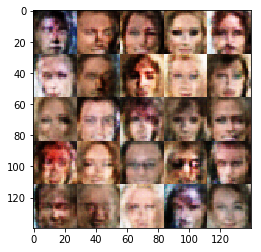

Epoch 1/10 Step 1700... Discriminator Loss: 1.2462... Generator Loss: 0.8576 ... Time spent=0.0888
Epoch 1/10 Step 1800... Discriminator Loss: 1.2525... Generator Loss: 0.6847 ... Time spent=0.0864


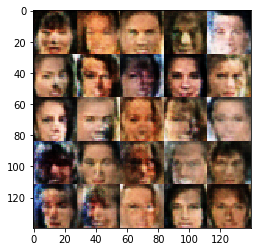

Epoch 1/10 Step 1900... Discriminator Loss: 1.2446... Generator Loss: 0.6058 ... Time spent=0.0877
Epoch 1/10 Step 2000... Discriminator Loss: 1.1202... Generator Loss: 0.9429 ... Time spent=0.0895


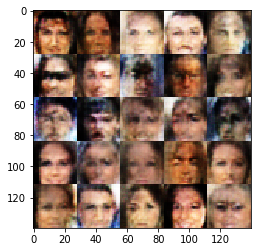

Epoch 1/10 Step 2100... Discriminator Loss: 1.1184... Generator Loss: 0.8757 ... Time spent=0.0892
Epoch 1/10 Step 2200... Discriminator Loss: 1.3088... Generator Loss: 0.7415 ... Time spent=0.0878


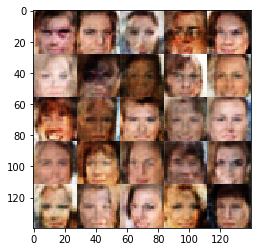

Epoch 1/10 Step 2300... Discriminator Loss: 1.3203... Generator Loss: 0.5983 ... Time spent=0.0901
Epoch 1/10 Step 2400... Discriminator Loss: 1.2273... Generator Loss: 0.7606 ... Time spent=0.0889


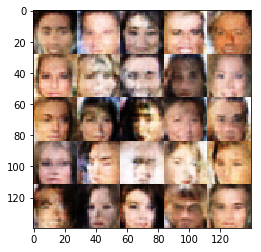

Epoch 1/10 Step 2500... Discriminator Loss: 1.2048... Generator Loss: 0.7473 ... Time spent=0.0890
Epoch 1/10 Step 2600... Discriminator Loss: 1.2705... Generator Loss: 0.6663 ... Time spent=0.0891


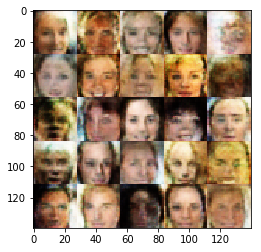

Epoch 1/10 Step 2700... Discriminator Loss: 1.3367... Generator Loss: 0.5440 ... Time spent=0.0872
Epoch 1/10 Step 2800... Discriminator Loss: 1.2389... Generator Loss: 0.6592 ... Time spent=0.0873


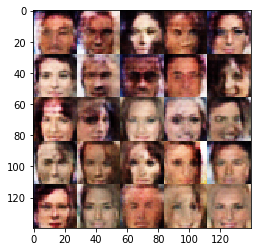

Epoch 1/10 Step 2900... Discriminator Loss: 1.1406... Generator Loss: 0.8048 ... Time spent=0.0879
Epoch 1/10 Step 3000... Discriminator Loss: 1.2504... Generator Loss: 0.6071 ... Time spent=0.0871


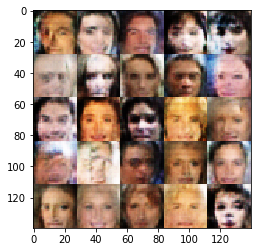

Epoch 1/10 Step 3100... Discriminator Loss: 1.3152... Generator Loss: 0.6172 ... Time spent=0.0909
Epoch 1/10 Step 3200... Discriminator Loss: 1.2157... Generator Loss: 0.6839 ... Time spent=0.0902


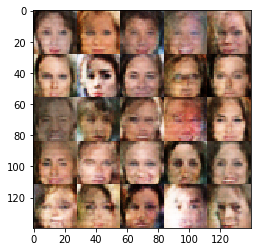

Epoch 1/10 Step 3300... Discriminator Loss: 1.3990... Generator Loss: 0.4862 ... Time spent=0.0896
Epoch 1/10 Step 3400... Discriminator Loss: 1.2790... Generator Loss: 0.5762 ... Time spent=0.0886


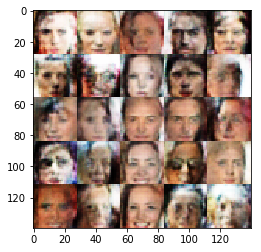

Epoch 1/10 Step 3500... Discriminator Loss: 1.3377... Generator Loss: 0.5165 ... Time spent=0.0881
Epoch 1/10 Step 3600... Discriminator Loss: 1.2327... Generator Loss: 0.6378 ... Time spent=0.0892


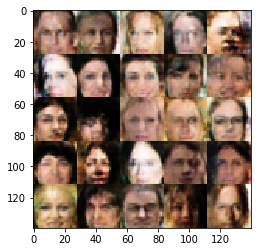

Epoch 1/10 Step 3700... Discriminator Loss: 1.2875... Generator Loss: 0.7019 ... Time spent=0.0882
Epoch 1/10 Step 3800... Discriminator Loss: 1.5032... Generator Loss: 0.4157 ... Time spent=0.0872


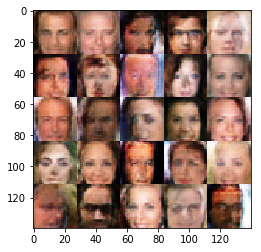

Epoch 1/10 Step 3900... Discriminator Loss: 1.2219... Generator Loss: 0.8004 ... Time spent=0.0868
Epoch 1/10 Step 4000... Discriminator Loss: 1.2973... Generator Loss: 0.6607 ... Time spent=0.0878


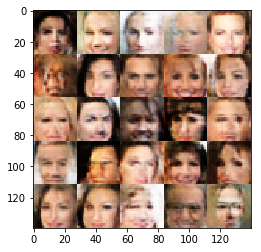

Epoch 1/10 Step 4100... Discriminator Loss: 1.2479... Generator Loss: 0.6266 ... Time spent=0.0894
Epoch 1/10 Step 4200... Discriminator Loss: 1.2472... Generator Loss: 0.6644 ... Time spent=0.0877


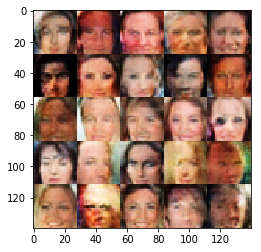

Epoch 1/10 Step 4300... Discriminator Loss: 1.2038... Generator Loss: 0.7245 ... Time spent=0.0870
Epoch 1/10 Step 4400... Discriminator Loss: 1.3361... Generator Loss: 0.5559 ... Time spent=0.0889


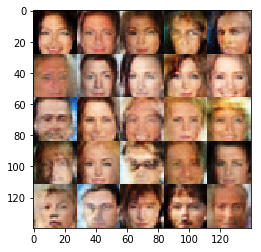

Epoch 1/10 Step 4500... Discriminator Loss: 1.2352... Generator Loss: 0.8287 ... Time spent=0.0893
Epoch 1/10 Step 4600... Discriminator Loss: 1.1647... Generator Loss: 0.8806 ... Time spent=0.0886


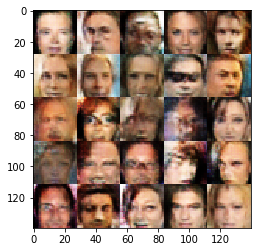

Epoch 1/10 Step 4700... Discriminator Loss: 1.3642... Generator Loss: 0.5527 ... Time spent=0.0906
Epoch 1/10 Step 4800... Discriminator Loss: 1.2187... Generator Loss: 0.7534 ... Time spent=0.0878


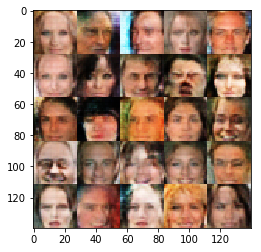

Epoch 1/10 Step 4900... Discriminator Loss: 1.3111... Generator Loss: 0.5380 ... Time spent=0.0903
Epoch 1/10 Step 5000... Discriminator Loss: 1.4774... Generator Loss: 0.4902 ... Time spent=0.0900


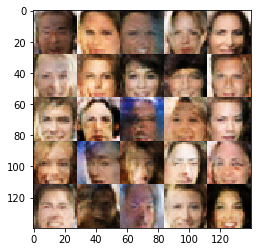

Epoch 1/10 Step 5100... Discriminator Loss: 1.3477... Generator Loss: 0.6771 ... Time spent=0.0885
Epoch 1/10 Step 5200... Discriminator Loss: 1.2916... Generator Loss: 0.5716 ... Time spent=0.0871


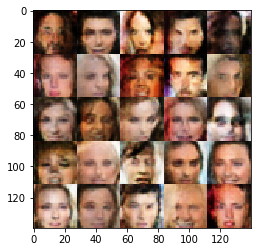

Epoch 1/10 Step 5300... Discriminator Loss: 1.2760... Generator Loss: 0.5963 ... Time spent=0.0890
Epoch 1/10 Step 5400... Discriminator Loss: 1.1458... Generator Loss: 0.8534 ... Time spent=0.0890


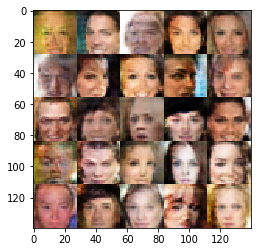

Epoch 1/10 Step 5500... Discriminator Loss: 1.3455... Generator Loss: 0.5354 ... Time spent=0.0901
Epoch 1/10 Step 5600... Discriminator Loss: 1.3301... Generator Loss: 0.5286 ... Time spent=0.0873


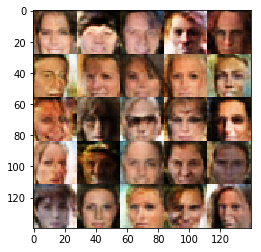

Epoch 1/10 Step 5700... Discriminator Loss: 1.1621... Generator Loss: 0.6974 ... Time spent=0.0892
Epoch 1/10 Step 5800... Discriminator Loss: 1.5234... Generator Loss: 0.4553 ... Time spent=0.0893


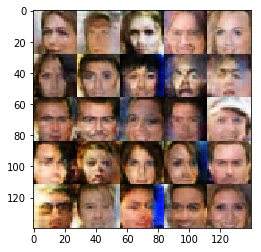

Epoch 1/10 Step 5900... Discriminator Loss: 1.2862... Generator Loss: 0.7007 ... Time spent=0.0888
Epoch 1/10 Step 6000... Discriminator Loss: 1.3954... Generator Loss: 0.7087 ... Time spent=0.0882


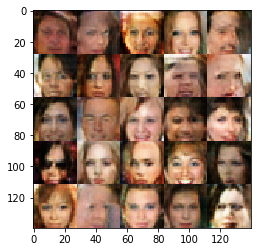

Epoch 1/10 Step 6100... Discriminator Loss: 1.4335... Generator Loss: 0.4670 ... Time spent=0.0890
Epoch 1/10 Step 6200... Discriminator Loss: 1.5254... Generator Loss: 0.3881 ... Time spent=0.0882


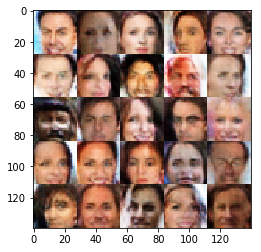

Epoch 1/10 Step 6300... Discriminator Loss: 1.5948... Generator Loss: 0.4116 ... Time spent=0.0900
Epoch 2/10 Step 6400... Discriminator Loss: 1.4023... Generator Loss: 0.5979 ... Time spent=0.0873


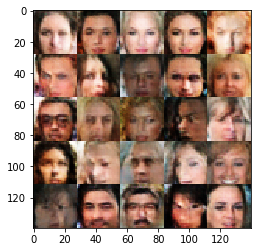

Epoch 2/10 Step 6500... Discriminator Loss: 1.2214... Generator Loss: 0.7463 ... Time spent=0.0866
Epoch 2/10 Step 6600... Discriminator Loss: 1.2141... Generator Loss: 0.6610 ... Time spent=0.0882


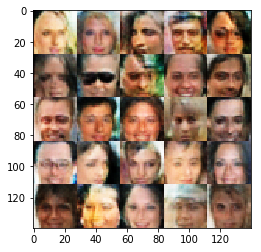

Epoch 2/10 Step 6700... Discriminator Loss: 1.4758... Generator Loss: 0.4841 ... Time spent=0.0896
Epoch 2/10 Step 6800... Discriminator Loss: 1.3538... Generator Loss: 0.5162 ... Time spent=0.0878


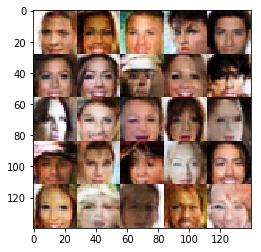

Epoch 2/10 Step 6900... Discriminator Loss: 1.3964... Generator Loss: 0.4862 ... Time spent=0.0885
Epoch 2/10 Step 7000... Discriminator Loss: 1.2167... Generator Loss: 0.6756 ... Time spent=0.0872


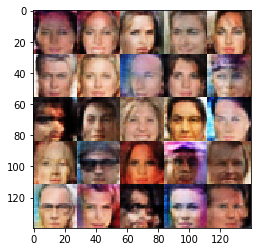

Epoch 2/10 Step 7100... Discriminator Loss: 1.3893... Generator Loss: 0.4806 ... Time spent=0.0885
Epoch 2/10 Step 7200... Discriminator Loss: 1.3306... Generator Loss: 0.5968 ... Time spent=0.0904


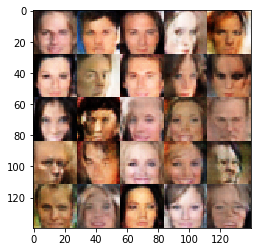

Epoch 2/10 Step 7300... Discriminator Loss: 1.2681... Generator Loss: 0.9050 ... Time spent=0.0898
Epoch 2/10 Step 7400... Discriminator Loss: 1.2602... Generator Loss: 0.6708 ... Time spent=0.0893


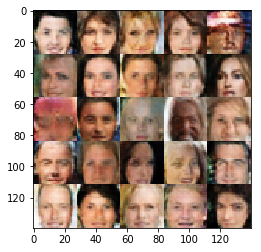

Epoch 2/10 Step 7500... Discriminator Loss: 1.4048... Generator Loss: 0.4837 ... Time spent=0.0882
Epoch 2/10 Step 7600... Discriminator Loss: 1.1292... Generator Loss: 0.7847 ... Time spent=0.0891


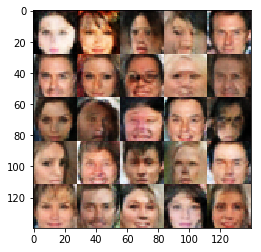

Epoch 2/10 Step 7700... Discriminator Loss: 1.2968... Generator Loss: 0.5757 ... Time spent=0.0892
Epoch 2/10 Step 7800... Discriminator Loss: 1.2167... Generator Loss: 0.6277 ... Time spent=0.0899


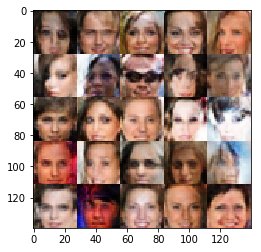

Epoch 2/10 Step 7900... Discriminator Loss: 1.3506... Generator Loss: 0.5115 ... Time spent=0.0902
Epoch 2/10 Step 8000... Discriminator Loss: 1.3071... Generator Loss: 0.5285 ... Time spent=0.0899


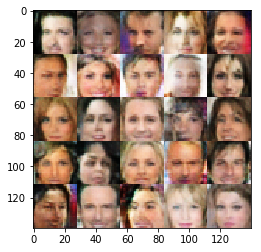

Epoch 2/10 Step 8100... Discriminator Loss: 1.2773... Generator Loss: 0.6272 ... Time spent=0.0869
Epoch 2/10 Step 8200... Discriminator Loss: 1.2384... Generator Loss: 0.6809 ... Time spent=0.0903


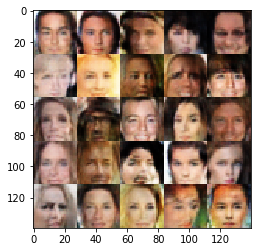

Epoch 2/10 Step 8300... Discriminator Loss: 1.4479... Generator Loss: 0.4539 ... Time spent=0.0900
Epoch 2/10 Step 8400... Discriminator Loss: 1.2467... Generator Loss: 0.7211 ... Time spent=0.0884


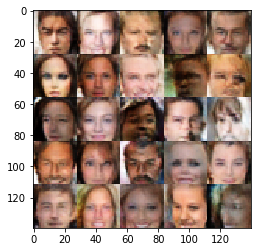

Epoch 2/10 Step 8500... Discriminator Loss: 1.2485... Generator Loss: 0.6398 ... Time spent=0.0889
Epoch 2/10 Step 8600... Discriminator Loss: 1.1207... Generator Loss: 0.8419 ... Time spent=0.0891


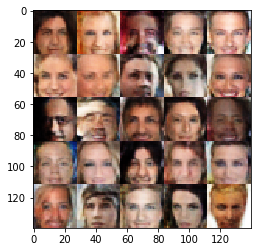

Epoch 2/10 Step 8700... Discriminator Loss: 1.3391... Generator Loss: 0.6480 ... Time spent=0.0875
Epoch 2/10 Step 8800... Discriminator Loss: 1.2009... Generator Loss: 0.6792 ... Time spent=0.0890


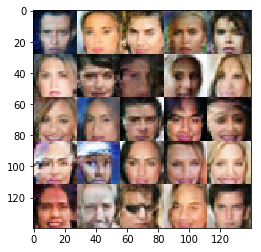

Epoch 2/10 Step 8900... Discriminator Loss: 1.2108... Generator Loss: 0.6244 ... Time spent=0.0873
Epoch 2/10 Step 9000... Discriminator Loss: 1.3683... Generator Loss: 0.5434 ... Time spent=0.0908


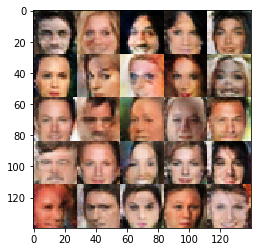

Epoch 2/10 Step 9100... Discriminator Loss: 1.5765... Generator Loss: 0.3965 ... Time spent=0.0875
Epoch 2/10 Step 9200... Discriminator Loss: 1.1125... Generator Loss: 0.7699 ... Time spent=0.0903


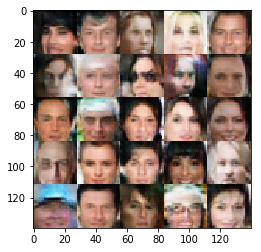

Epoch 2/10 Step 9300... Discriminator Loss: 1.5977... Generator Loss: 0.3577 ... Time spent=0.0899
Epoch 2/10 Step 9400... Discriminator Loss: 1.3010... Generator Loss: 0.6332 ... Time spent=0.0898


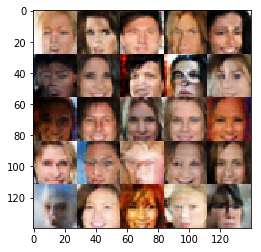

Epoch 2/10 Step 9500... Discriminator Loss: 1.4782... Generator Loss: 0.5142 ... Time spent=0.0900
Epoch 2/10 Step 9600... Discriminator Loss: 1.6396... Generator Loss: 0.3858 ... Time spent=0.0893


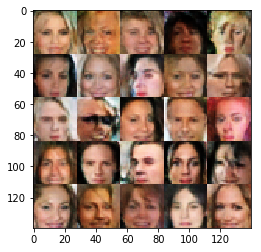

Epoch 2/10 Step 9700... Discriminator Loss: 1.2392... Generator Loss: 0.5927 ... Time spent=0.0875
Epoch 2/10 Step 9800... Discriminator Loss: 1.2850... Generator Loss: 0.6926 ... Time spent=0.0882


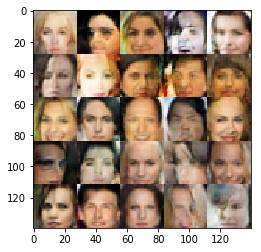

Epoch 2/10 Step 9900... Discriminator Loss: 1.5042... Generator Loss: 0.4007 ... Time spent=0.0896
Epoch 2/10 Step 10000... Discriminator Loss: 1.2655... Generator Loss: 0.7123 ... Time spent=0.0875


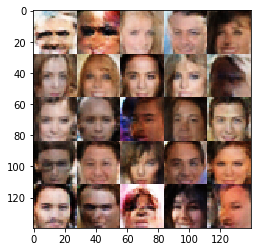

Epoch 2/10 Step 10100... Discriminator Loss: 1.3507... Generator Loss: 0.5061 ... Time spent=0.0895
Epoch 2/10 Step 10200... Discriminator Loss: 1.1187... Generator Loss: 0.7697 ... Time spent=0.0889


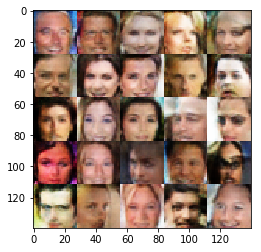

Epoch 2/10 Step 10300... Discriminator Loss: 1.0986... Generator Loss: 0.7200 ... Time spent=0.0870
Epoch 2/10 Step 10400... Discriminator Loss: 1.2007... Generator Loss: 0.8081 ... Time spent=0.0864


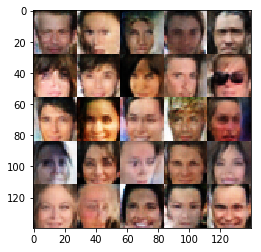

Epoch 2/10 Step 10500... Discriminator Loss: 1.4547... Generator Loss: 0.4278 ... Time spent=0.0891
Epoch 2/10 Step 10600... Discriminator Loss: 1.3223... Generator Loss: 0.5766 ... Time spent=0.0887


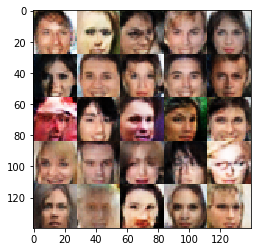

Epoch 2/10 Step 10700... Discriminator Loss: 1.4075... Generator Loss: 0.5208 ... Time spent=0.0890
Epoch 2/10 Step 10800... Discriminator Loss: 1.4355... Generator Loss: 0.5698 ... Time spent=0.0897


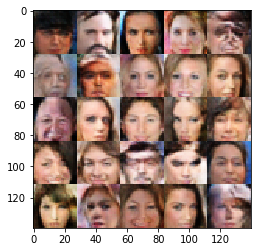

Epoch 2/10 Step 10900... Discriminator Loss: 1.3244... Generator Loss: 0.5568 ... Time spent=0.0894
Epoch 2/10 Step 11000... Discriminator Loss: 1.4316... Generator Loss: 0.4622 ... Time spent=0.0901


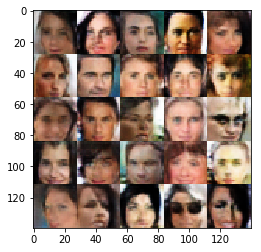

Epoch 2/10 Step 11100... Discriminator Loss: 1.4344... Generator Loss: 0.4392 ... Time spent=0.0900
Epoch 2/10 Step 11200... Discriminator Loss: 1.4230... Generator Loss: 0.4689 ... Time spent=0.0897


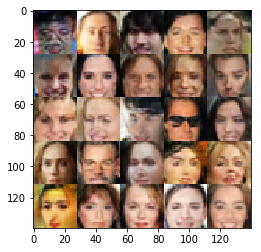

Epoch 2/10 Step 11300... Discriminator Loss: 1.5908... Generator Loss: 0.4384 ... Time spent=0.0896
Epoch 2/10 Step 11400... Discriminator Loss: 1.2418... Generator Loss: 0.6331 ... Time spent=0.0888


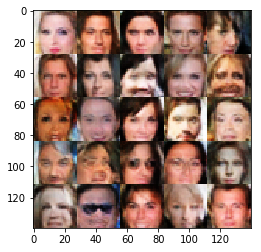

Epoch 2/10 Step 11500... Discriminator Loss: 1.2707... Generator Loss: 0.6123 ... Time spent=0.0876
Epoch 2/10 Step 11600... Discriminator Loss: 1.0666... Generator Loss: 0.7427 ... Time spent=0.0897


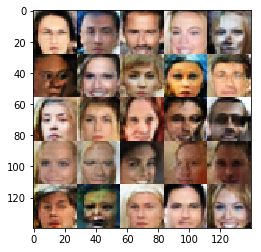

Epoch 2/10 Step 11700... Discriminator Loss: 1.3559... Generator Loss: 0.5418 ... Time spent=0.0873
Epoch 2/10 Step 11800... Discriminator Loss: 1.4292... Generator Loss: 0.4461 ... Time spent=0.0889


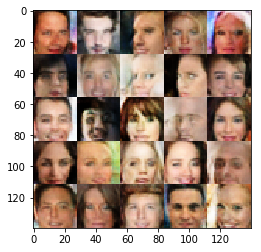

Epoch 2/10 Step 11900... Discriminator Loss: 1.3511... Generator Loss: 0.5249 ... Time spent=0.0891
Epoch 2/10 Step 12000... Discriminator Loss: 1.3170... Generator Loss: 0.5314 ... Time spent=0.0898


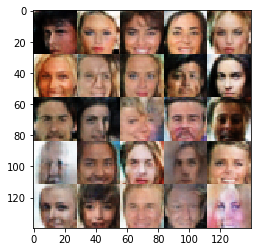

Epoch 2/10 Step 12100... Discriminator Loss: 1.4562... Generator Loss: 0.5291 ... Time spent=0.0873
Epoch 2/10 Step 12200... Discriminator Loss: 1.3466... Generator Loss: 0.5297 ... Time spent=0.0896


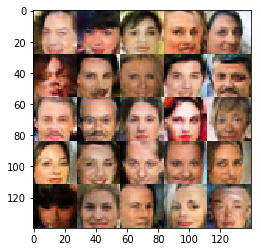

Epoch 2/10 Step 12300... Discriminator Loss: 1.1570... Generator Loss: 0.8410 ... Time spent=0.0876
Epoch 2/10 Step 12400... Discriminator Loss: 1.2966... Generator Loss: 0.6169 ... Time spent=0.0878


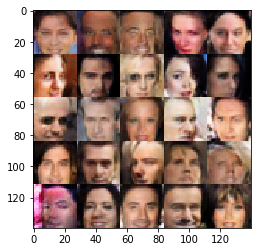

Epoch 2/10 Step 12500... Discriminator Loss: 1.3889... Generator Loss: 0.6699 ... Time spent=0.0879
Epoch 2/10 Step 12600... Discriminator Loss: 1.5086... Generator Loss: 0.4421 ... Time spent=0.0926


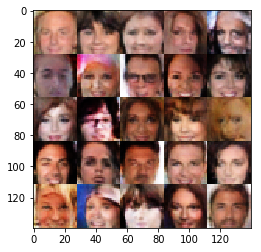

Epoch 3/10 Step 12700... Discriminator Loss: 1.3856... Generator Loss: 0.5645 ... Time spent=0.0952
Epoch 3/10 Step 12800... Discriminator Loss: 1.3959... Generator Loss: 0.5715 ... Time spent=0.0888


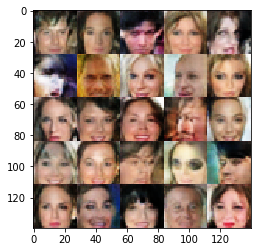

Epoch 3/10 Step 12900... Discriminator Loss: 1.4056... Generator Loss: 0.4967 ... Time spent=0.0869
Epoch 3/10 Step 13000... Discriminator Loss: 1.4594... Generator Loss: 0.5399 ... Time spent=0.0901


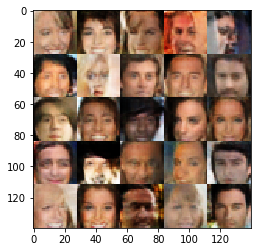

Epoch 3/10 Step 13100... Discriminator Loss: 1.5771... Generator Loss: 0.4312 ... Time spent=0.0874
Epoch 3/10 Step 13200... Discriminator Loss: 1.3679... Generator Loss: 0.5085 ... Time spent=0.0905


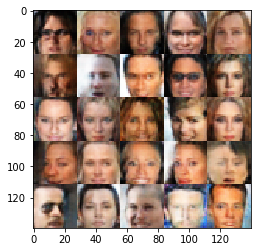

Epoch 3/10 Step 13300... Discriminator Loss: 1.3563... Generator Loss: 0.4968 ... Time spent=0.0869
Epoch 3/10 Step 13400... Discriminator Loss: 1.3292... Generator Loss: 0.6993 ... Time spent=0.0888


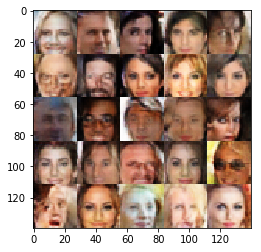

Epoch 3/10 Step 13500... Discriminator Loss: 1.4675... Generator Loss: 0.4379 ... Time spent=0.0887
Epoch 3/10 Step 13600... Discriminator Loss: 1.4041... Generator Loss: 0.5064 ... Time spent=0.0878


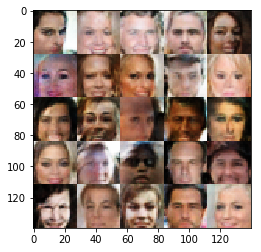

Epoch 3/10 Step 13700... Discriminator Loss: 1.2494... Generator Loss: 0.6820 ... Time spent=0.0884
Epoch 3/10 Step 13800... Discriminator Loss: 1.2431... Generator Loss: 0.5600 ... Time spent=0.0888


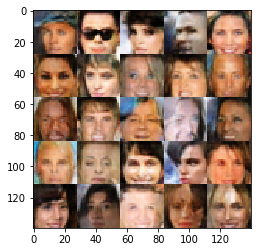

Epoch 3/10 Step 13900... Discriminator Loss: 1.4819... Generator Loss: 0.4041 ... Time spent=0.0904
Epoch 3/10 Step 14000... Discriminator Loss: 1.4459... Generator Loss: 0.4727 ... Time spent=0.0880


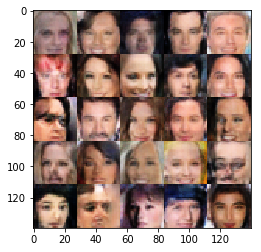

Epoch 3/10 Step 14100... Discriminator Loss: 1.2612... Generator Loss: 0.6459 ... Time spent=0.0901
Epoch 3/10 Step 14200... Discriminator Loss: 1.2288... Generator Loss: 0.6024 ... Time spent=0.0888


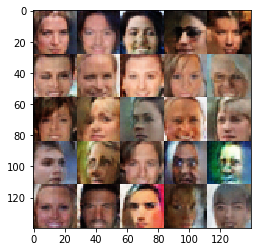

Epoch 3/10 Step 14300... Discriminator Loss: 1.2785... Generator Loss: 0.7139 ... Time spent=0.0900
Epoch 3/10 Step 14400... Discriminator Loss: 1.3663... Generator Loss: 0.5238 ... Time spent=0.0893


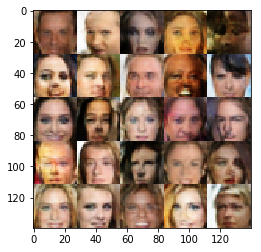

Epoch 3/10 Step 14500... Discriminator Loss: 1.3970... Generator Loss: 0.5024 ... Time spent=0.0892
Epoch 3/10 Step 14600... Discriminator Loss: 1.4524... Generator Loss: 0.4520 ... Time spent=0.0886


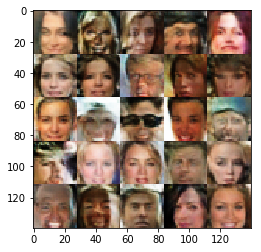

Epoch 3/10 Step 14700... Discriminator Loss: 1.3891... Generator Loss: 0.5496 ... Time spent=0.0896
Epoch 3/10 Step 14800... Discriminator Loss: 1.4447... Generator Loss: 0.6839 ... Time spent=0.0897


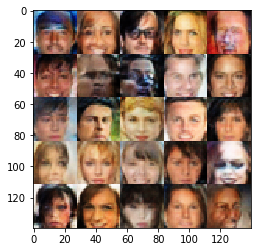

Epoch 3/10 Step 14900... Discriminator Loss: 1.3629... Generator Loss: 0.5778 ... Time spent=0.0889
Epoch 3/10 Step 15000... Discriminator Loss: 1.3121... Generator Loss: 0.5486 ... Time spent=0.0895


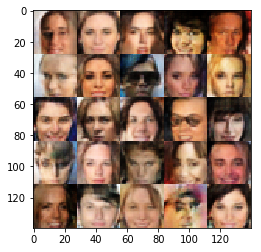

Epoch 3/10 Step 15100... Discriminator Loss: 1.5721... Generator Loss: 0.4322 ... Time spent=0.0917
Epoch 3/10 Step 15200... Discriminator Loss: 1.3327... Generator Loss: 0.5568 ... Time spent=0.0903


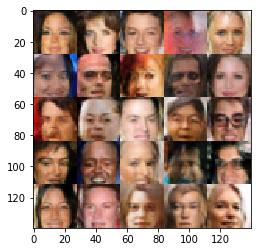

Epoch 3/10 Step 15300... Discriminator Loss: 1.2071... Generator Loss: 0.6562 ... Time spent=0.0887
Epoch 3/10 Step 15400... Discriminator Loss: 1.2645... Generator Loss: 0.5782 ... Time spent=0.0882


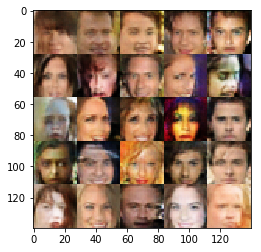

Epoch 3/10 Step 15500... Discriminator Loss: 1.8425... Generator Loss: 0.4303 ... Time spent=0.0916
Epoch 3/10 Step 15600... Discriminator Loss: 1.3038... Generator Loss: 0.6130 ... Time spent=0.0887


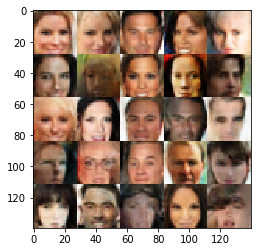

Epoch 3/10 Step 15700... Discriminator Loss: 1.3129... Generator Loss: 0.5154 ... Time spent=0.0887
Epoch 3/10 Step 15800... Discriminator Loss: 1.3627... Generator Loss: 0.4930 ... Time spent=0.0892


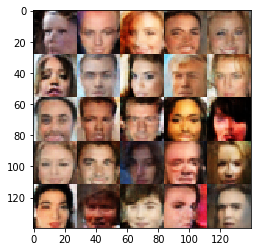

Epoch 3/10 Step 15900... Discriminator Loss: 1.3586... Generator Loss: 0.5104 ... Time spent=0.0882
Epoch 3/10 Step 16000... Discriminator Loss: 1.4717... Generator Loss: 0.4763 ... Time spent=0.0900


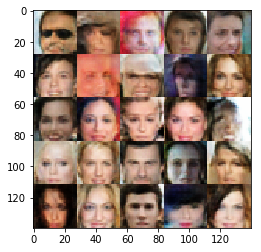

Epoch 3/10 Step 16100... Discriminator Loss: 1.3528... Generator Loss: 0.6180 ... Time spent=0.0883
Epoch 3/10 Step 16200... Discriminator Loss: 1.1219... Generator Loss: 0.7051 ... Time spent=0.0882


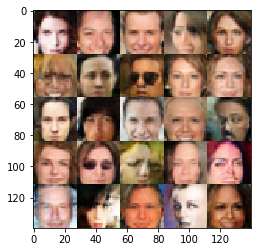

Epoch 3/10 Step 16300... Discriminator Loss: 1.3579... Generator Loss: 0.6552 ... Time spent=0.0883
Epoch 3/10 Step 16400... Discriminator Loss: 1.4412... Generator Loss: 0.4723 ... Time spent=0.0897


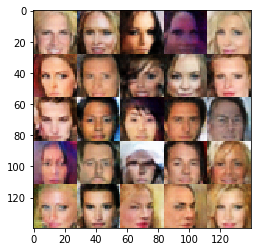

Epoch 3/10 Step 16500... Discriminator Loss: 1.2222... Generator Loss: 0.6552 ... Time spent=0.0893
Epoch 3/10 Step 16600... Discriminator Loss: 1.3865... Generator Loss: 0.4796 ... Time spent=0.0887


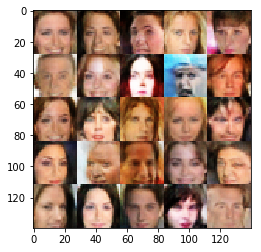

Epoch 3/10 Step 16700... Discriminator Loss: 1.4734... Generator Loss: 0.4556 ... Time spent=0.0874
Epoch 3/10 Step 16800... Discriminator Loss: 1.3243... Generator Loss: 0.5714 ... Time spent=0.0895


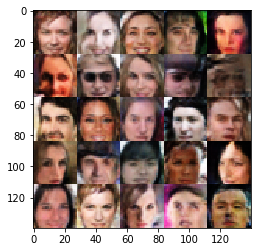

Epoch 3/10 Step 16900... Discriminator Loss: 1.6155... Generator Loss: 0.4022 ... Time spent=0.0875
Epoch 3/10 Step 17000... Discriminator Loss: 1.3592... Generator Loss: 0.5881 ... Time spent=0.0881


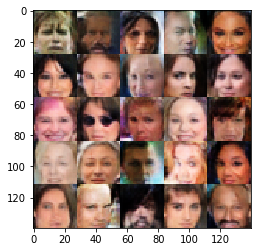

Epoch 3/10 Step 17100... Discriminator Loss: 1.4075... Generator Loss: 0.6088 ... Time spent=0.0890
Epoch 3/10 Step 17200... Discriminator Loss: 1.1958... Generator Loss: 0.6828 ... Time spent=0.0902


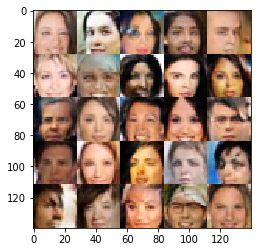

Epoch 3/10 Step 17300... Discriminator Loss: 1.0871... Generator Loss: 0.8603 ... Time spent=0.0890
Epoch 3/10 Step 17400... Discriminator Loss: 1.3422... Generator Loss: 0.6521 ... Time spent=0.0896


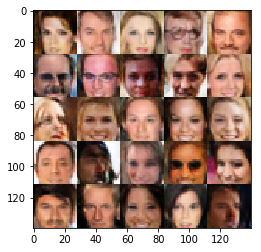

Epoch 3/10 Step 17500... Discriminator Loss: 1.2165... Generator Loss: 0.6188 ... Time spent=0.0890
Epoch 3/10 Step 17600... Discriminator Loss: 1.4463... Generator Loss: 0.4580 ... Time spent=0.0882


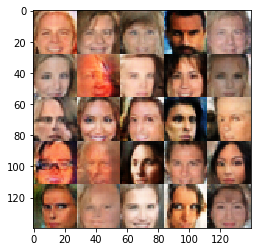

Epoch 3/10 Step 17700... Discriminator Loss: 1.3957... Generator Loss: 0.4812 ... Time spent=0.0880
Epoch 3/10 Step 17800... Discriminator Loss: 1.1759... Generator Loss: 0.6880 ... Time spent=0.0885


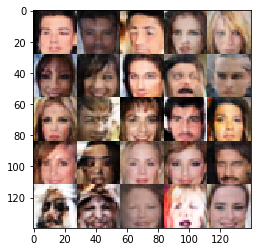

Epoch 3/10 Step 17900... Discriminator Loss: 1.3116... Generator Loss: 0.5442 ... Time spent=0.0887
Epoch 3/10 Step 18000... Discriminator Loss: 1.3231... Generator Loss: 0.5180 ... Time spent=0.0895


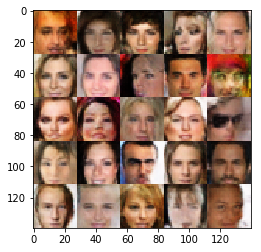

Epoch 3/10 Step 18100... Discriminator Loss: 1.3515... Generator Loss: 0.5540 ... Time spent=0.0894
Epoch 3/10 Step 18200... Discriminator Loss: 1.4204... Generator Loss: 0.4951 ... Time spent=0.0886


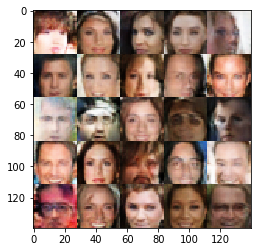

Epoch 3/10 Step 18300... Discriminator Loss: 1.4606... Generator Loss: 0.4878 ... Time spent=0.0880
Epoch 3/10 Step 18400... Discriminator Loss: 1.3344... Generator Loss: 0.5639 ... Time spent=0.0881


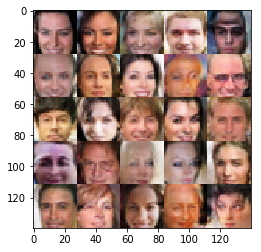

Epoch 3/10 Step 18500... Discriminator Loss: 1.3632... Generator Loss: 0.5259 ... Time spent=0.0895
Epoch 3/10 Step 18600... Discriminator Loss: 1.4264... Generator Loss: 0.4464 ... Time spent=0.0888


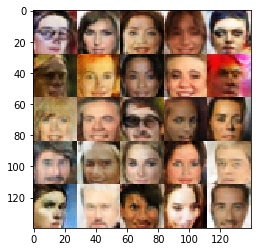

Epoch 3/10 Step 18700... Discriminator Loss: 1.4239... Generator Loss: 0.4516 ... Time spent=0.0867
Epoch 3/10 Step 18800... Discriminator Loss: 1.1588... Generator Loss: 0.6370 ... Time spent=0.0895


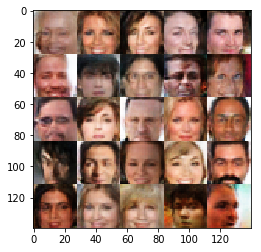

Epoch 3/10 Step 18900... Discriminator Loss: 1.3991... Generator Loss: 0.5039 ... Time spent=0.0887
Epoch 4/10 Step 19000... Discriminator Loss: 1.5145... Generator Loss: 0.3960 ... Time spent=0.0909


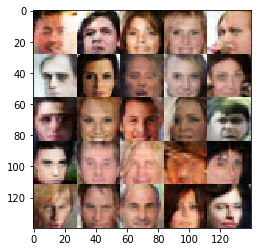

Epoch 4/10 Step 19100... Discriminator Loss: 1.3566... Generator Loss: 0.5244 ... Time spent=0.0898
Epoch 4/10 Step 19200... Discriminator Loss: 1.6162... Generator Loss: 0.3539 ... Time spent=0.0877


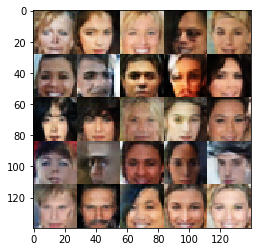

Epoch 4/10 Step 19300... Discriminator Loss: 1.1747... Generator Loss: 0.8077 ... Time spent=0.0887
Epoch 4/10 Step 19400... Discriminator Loss: 1.4724... Generator Loss: 0.4547 ... Time spent=0.0905


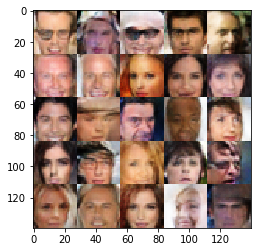

Epoch 4/10 Step 19500... Discriminator Loss: 1.5303... Generator Loss: 0.4476 ... Time spent=0.0891
Epoch 4/10 Step 19600... Discriminator Loss: 1.3254... Generator Loss: 0.5798 ... Time spent=0.0877


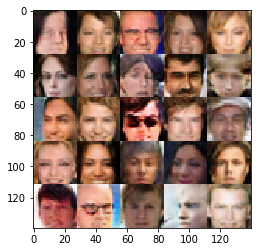

Epoch 4/10 Step 19700... Discriminator Loss: 1.5527... Generator Loss: 0.3869 ... Time spent=0.0896
Epoch 4/10 Step 19800... Discriminator Loss: 1.1945... Generator Loss: 0.6353 ... Time spent=0.0881


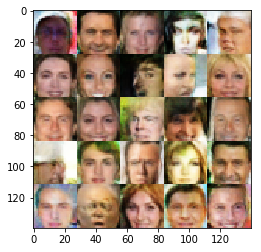

Epoch 4/10 Step 19900... Discriminator Loss: 1.3466... Generator Loss: 0.5333 ... Time spent=0.0886
Epoch 4/10 Step 20000... Discriminator Loss: 1.2397... Generator Loss: 0.5817 ... Time spent=0.0883


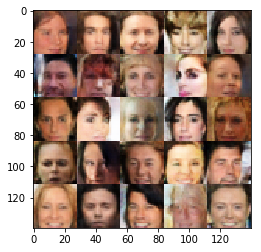

Epoch 4/10 Step 20100... Discriminator Loss: 1.4466... Generator Loss: 0.5855 ... Time spent=0.0890
Epoch 4/10 Step 20200... Discriminator Loss: 1.3375... Generator Loss: 0.5197 ... Time spent=0.0871


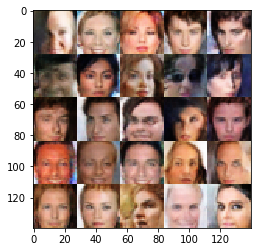

Epoch 4/10 Step 20300... Discriminator Loss: 1.1415... Generator Loss: 0.7244 ... Time spent=0.0897
Epoch 4/10 Step 20400... Discriminator Loss: 1.2227... Generator Loss: 0.6024 ... Time spent=0.0888


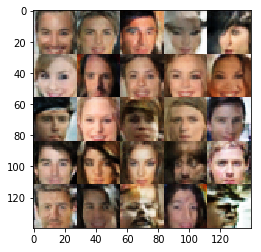

Epoch 4/10 Step 20500... Discriminator Loss: 1.4880... Generator Loss: 0.4084 ... Time spent=0.0888
Epoch 4/10 Step 20600... Discriminator Loss: 1.5189... Generator Loss: 0.4491 ... Time spent=0.0880


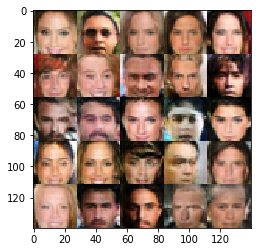

Epoch 4/10 Step 20700... Discriminator Loss: 1.5149... Generator Loss: 0.4150 ... Time spent=0.0897
Epoch 4/10 Step 20800... Discriminator Loss: 1.3108... Generator Loss: 0.5325 ... Time spent=0.0898


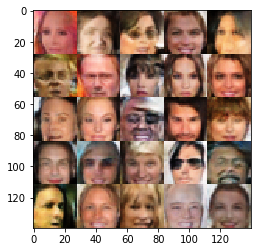

Epoch 4/10 Step 20900... Discriminator Loss: 1.2987... Generator Loss: 0.5672 ... Time spent=0.0887
Epoch 4/10 Step 21000... Discriminator Loss: 1.4992... Generator Loss: 0.4257 ... Time spent=0.0879


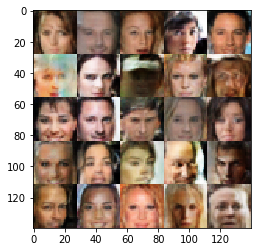

Epoch 4/10 Step 21100... Discriminator Loss: 1.2205... Generator Loss: 0.6135 ... Time spent=0.0886
Epoch 4/10 Step 21200... Discriminator Loss: 1.3458... Generator Loss: 0.6147 ... Time spent=0.0895


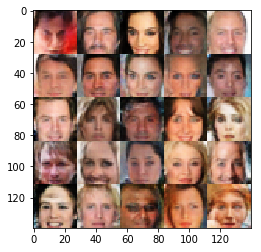

Epoch 4/10 Step 21300... Discriminator Loss: 1.2105... Generator Loss: 0.6865 ... Time spent=0.0897
Epoch 4/10 Step 21400... Discriminator Loss: 1.4869... Generator Loss: 0.4528 ... Time spent=0.0882


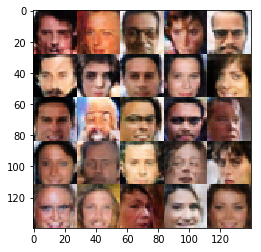

Epoch 4/10 Step 21500... Discriminator Loss: 1.2421... Generator Loss: 0.7356 ... Time spent=0.0891
Epoch 4/10 Step 21600... Discriminator Loss: 1.2758... Generator Loss: 0.6356 ... Time spent=0.0894


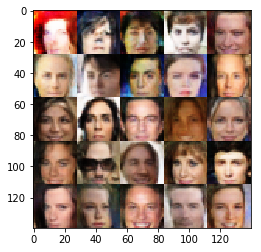

Epoch 4/10 Step 21700... Discriminator Loss: 1.6583... Generator Loss: 0.3439 ... Time spent=0.0878
Epoch 4/10 Step 21800... Discriminator Loss: 1.2190... Generator Loss: 0.7836 ... Time spent=0.0915


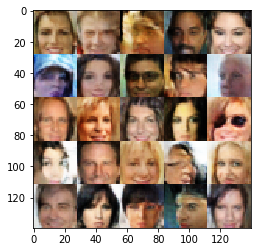

Epoch 4/10 Step 21900... Discriminator Loss: 1.4368... Generator Loss: 0.5447 ... Time spent=0.0882
Epoch 4/10 Step 22000... Discriminator Loss: 1.3867... Generator Loss: 0.4894 ... Time spent=0.0889


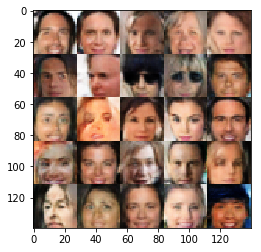

Epoch 4/10 Step 22100... Discriminator Loss: 1.2506... Generator Loss: 0.7049 ... Time spent=0.0882
Epoch 4/10 Step 22200... Discriminator Loss: 1.4201... Generator Loss: 0.4556 ... Time spent=0.0882


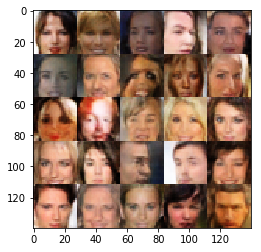

Epoch 4/10 Step 22300... Discriminator Loss: 1.6082... Generator Loss: 0.3742 ... Time spent=0.0885
Epoch 4/10 Step 22400... Discriminator Loss: 1.4993... Generator Loss: 0.4126 ... Time spent=0.0876


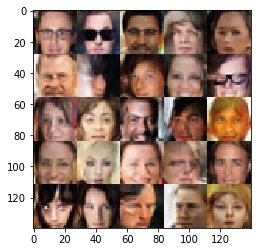

Epoch 4/10 Step 22500... Discriminator Loss: 1.2083... Generator Loss: 0.6655 ... Time spent=0.0892
Epoch 4/10 Step 22600... Discriminator Loss: 1.2739... Generator Loss: 0.7202 ... Time spent=0.0909


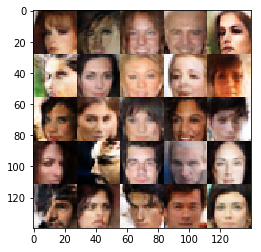

Epoch 4/10 Step 22700... Discriminator Loss: 1.5899... Generator Loss: 0.3680 ... Time spent=0.0886
Epoch 4/10 Step 22800... Discriminator Loss: 1.3019... Generator Loss: 0.6192 ... Time spent=0.0883


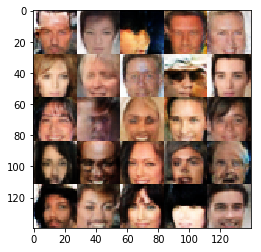

Epoch 4/10 Step 22900... Discriminator Loss: 1.3658... Generator Loss: 0.5682 ... Time spent=0.0883
Epoch 4/10 Step 23000... Discriminator Loss: 1.3809... Generator Loss: 0.4783 ... Time spent=0.0893


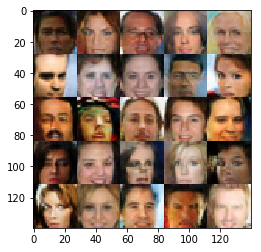

Epoch 4/10 Step 23100... Discriminator Loss: 1.3977... Generator Loss: 0.4597 ... Time spent=0.0890
Epoch 4/10 Step 23200... Discriminator Loss: 1.3346... Generator Loss: 0.6307 ... Time spent=0.0890


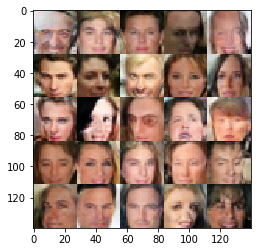

Epoch 4/10 Step 23300... Discriminator Loss: 1.2037... Generator Loss: 0.6714 ... Time spent=0.0883
Epoch 4/10 Step 23400... Discriminator Loss: 1.3770... Generator Loss: 0.5313 ... Time spent=0.0886


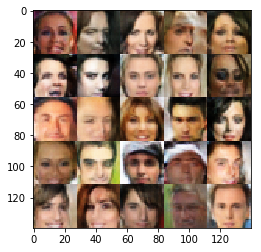

Epoch 4/10 Step 23500... Discriminator Loss: 1.3184... Generator Loss: 0.5374 ... Time spent=0.0890
Epoch 4/10 Step 23600... Discriminator Loss: 1.2914... Generator Loss: 0.5757 ... Time spent=0.0872


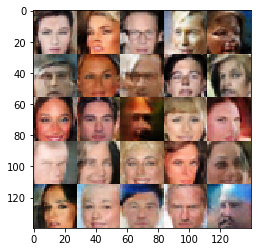

Epoch 4/10 Step 23700... Discriminator Loss: 1.3100... Generator Loss: 0.5600 ... Time spent=0.0898
Epoch 4/10 Step 23800... Discriminator Loss: 1.2587... Generator Loss: 0.5923 ... Time spent=0.0906


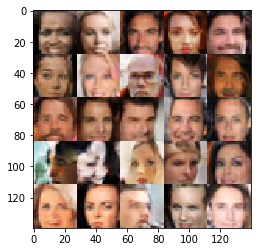

Epoch 4/10 Step 23900... Discriminator Loss: 1.4360... Generator Loss: 0.4252 ... Time spent=0.0894
Epoch 4/10 Step 24000... Discriminator Loss: 1.2476... Generator Loss: 0.6647 ... Time spent=0.0874


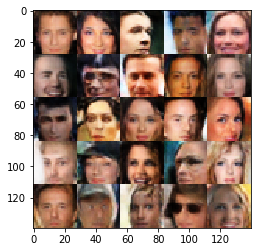

Epoch 4/10 Step 24100... Discriminator Loss: 1.3843... Generator Loss: 0.4802 ... Time spent=0.0891
Epoch 4/10 Step 24200... Discriminator Loss: 1.3870... Generator Loss: 0.4736 ... Time spent=0.0894


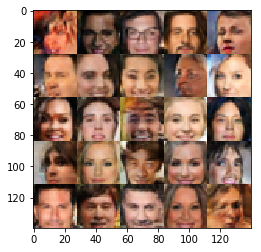

Epoch 4/10 Step 24300... Discriminator Loss: 1.5972... Generator Loss: 0.3682 ... Time spent=0.0889
Epoch 4/10 Step 24400... Discriminator Loss: 1.2612... Generator Loss: 0.6260 ... Time spent=0.0909


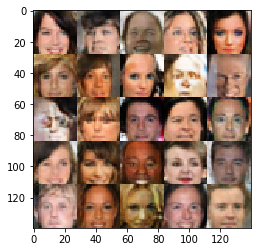

Epoch 4/10 Step 24500... Discriminator Loss: 1.0530... Generator Loss: 0.8660 ... Time spent=0.0898
Epoch 4/10 Step 24600... Discriminator Loss: 1.3592... Generator Loss: 0.6281 ... Time spent=0.0896


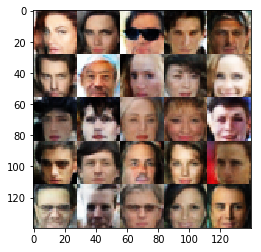

Epoch 4/10 Step 24700... Discriminator Loss: 1.3224... Generator Loss: 0.5352 ... Time spent=0.0884
Epoch 4/10 Step 24800... Discriminator Loss: 1.2943... Generator Loss: 0.5737 ... Time spent=0.0890


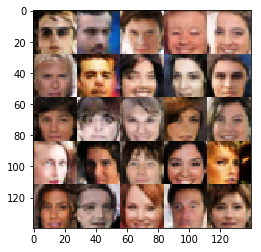

Epoch 4/10 Step 24900... Discriminator Loss: 1.4319... Generator Loss: 0.4497 ... Time spent=0.0882
Epoch 4/10 Step 25000... Discriminator Loss: 1.3854... Generator Loss: 0.6261 ... Time spent=0.0898


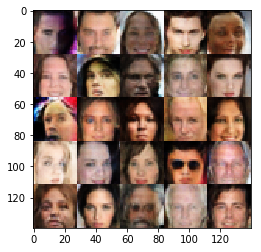

Epoch 4/10 Step 25100... Discriminator Loss: 1.1784... Generator Loss: 0.6765 ... Time spent=0.0909
Epoch 4/10 Step 25200... Discriminator Loss: 1.4486... Generator Loss: 0.4756 ... Time spent=0.0886


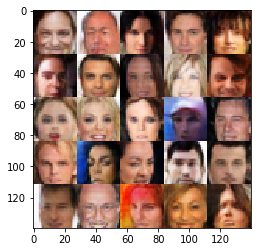

Epoch 4/10 Step 25300... Discriminator Loss: 1.6731... Generator Loss: 0.3352 ... Time spent=0.0875
Epoch 5/10 Step 25400... Discriminator Loss: 1.4249... Generator Loss: 0.5073 ... Time spent=0.0867


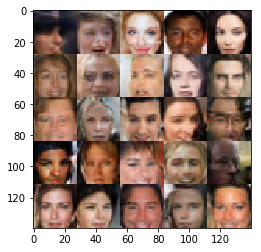

Epoch 5/10 Step 25500... Discriminator Loss: 1.1370... Generator Loss: 0.7861 ... Time spent=0.0884
Epoch 5/10 Step 25600... Discriminator Loss: 1.5452... Generator Loss: 0.4586 ... Time spent=0.0882


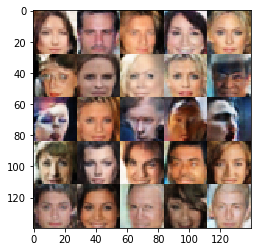

Epoch 5/10 Step 25700... Discriminator Loss: 1.2771... Generator Loss: 0.5525 ... Time spent=0.0870
Epoch 5/10 Step 25800... Discriminator Loss: 1.2498... Generator Loss: 0.5732 ... Time spent=0.0881


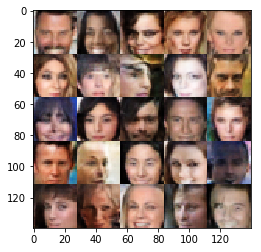

Epoch 5/10 Step 25900... Discriminator Loss: 1.3652... Generator Loss: 0.4776 ... Time spent=0.0874
Epoch 5/10 Step 26000... Discriminator Loss: 1.1527... Generator Loss: 0.6975 ... Time spent=0.0878


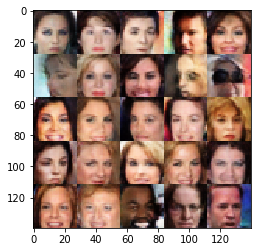

Epoch 5/10 Step 26100... Discriminator Loss: 1.7738... Generator Loss: 0.3004 ... Time spent=0.0870
Epoch 5/10 Step 26200... Discriminator Loss: 1.5349... Generator Loss: 0.3888 ... Time spent=0.0866


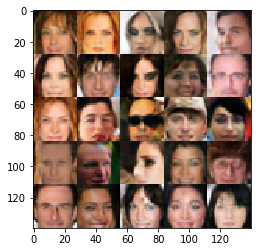

Epoch 5/10 Step 26300... Discriminator Loss: 1.6169... Generator Loss: 0.3652 ... Time spent=0.0897
Epoch 5/10 Step 26400... Discriminator Loss: 1.6117... Generator Loss: 0.3600 ... Time spent=0.0899


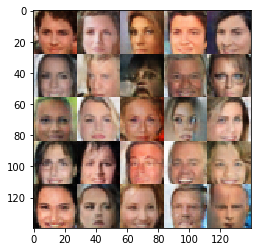

Epoch 5/10 Step 26500... Discriminator Loss: 1.2799... Generator Loss: 0.5647 ... Time spent=0.0901
Epoch 5/10 Step 26600... Discriminator Loss: 1.2492... Generator Loss: 0.6591 ... Time spent=0.0915


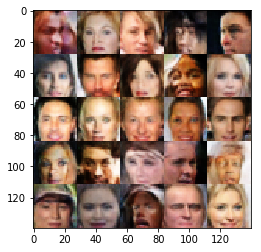

Epoch 5/10 Step 26700... Discriminator Loss: 1.3461... Generator Loss: 0.4945 ... Time spent=0.0901
Epoch 5/10 Step 26800... Discriminator Loss: 1.2988... Generator Loss: 0.6365 ... Time spent=0.0915


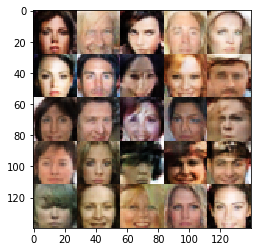

Epoch 5/10 Step 26900... Discriminator Loss: 1.2244... Generator Loss: 0.6172 ... Time spent=0.0901
Epoch 5/10 Step 27000... Discriminator Loss: 1.4116... Generator Loss: 0.4556 ... Time spent=0.0899


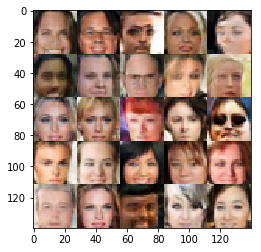

Epoch 5/10 Step 27100... Discriminator Loss: 1.2031... Generator Loss: 0.6034 ... Time spent=0.0895
Epoch 5/10 Step 27200... Discriminator Loss: 1.2926... Generator Loss: 0.5862 ... Time spent=0.0894


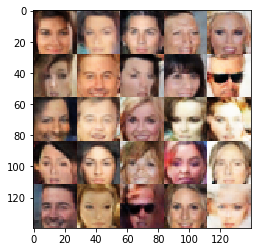

Epoch 5/10 Step 27300... Discriminator Loss: 1.6476... Generator Loss: 0.3313 ... Time spent=0.0897
Epoch 5/10 Step 27400... Discriminator Loss: 1.5321... Generator Loss: 0.3947 ... Time spent=0.0896


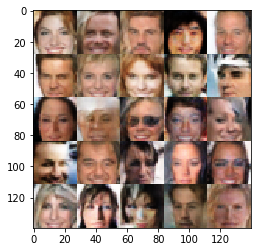

Epoch 5/10 Step 27500... Discriminator Loss: 1.4476... Generator Loss: 0.4454 ... Time spent=0.0877
Epoch 5/10 Step 27600... Discriminator Loss: 1.3095... Generator Loss: 0.5260 ... Time spent=0.0886


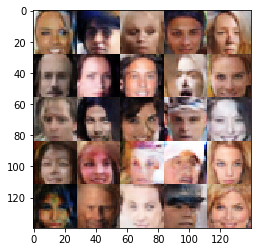

Epoch 5/10 Step 27700... Discriminator Loss: 1.4220... Generator Loss: 0.4454 ... Time spent=0.0866
Epoch 5/10 Step 27800... Discriminator Loss: 1.1529... Generator Loss: 0.7227 ... Time spent=0.0878


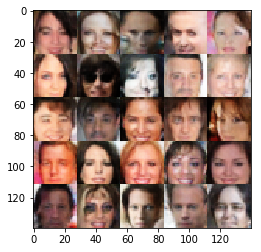

Epoch 5/10 Step 27900... Discriminator Loss: 1.3027... Generator Loss: 0.6758 ... Time spent=0.0891
Epoch 5/10 Step 28000... Discriminator Loss: 1.2695... Generator Loss: 0.5709 ... Time spent=0.0893


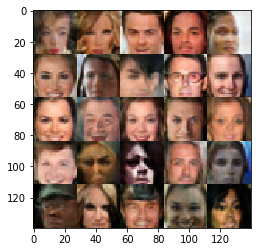

Epoch 5/10 Step 28100... Discriminator Loss: 1.5611... Generator Loss: 0.3803 ... Time spent=0.0882
Epoch 5/10 Step 28200... Discriminator Loss: 1.2371... Generator Loss: 0.6075 ... Time spent=0.0883


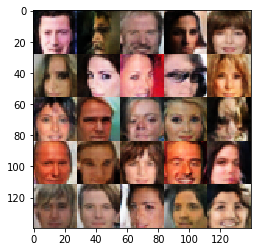

Epoch 5/10 Step 28300... Discriminator Loss: 1.4716... Generator Loss: 0.4248 ... Time spent=0.0889
Epoch 5/10 Step 28400... Discriminator Loss: 1.2833... Generator Loss: 0.5746 ... Time spent=0.0889


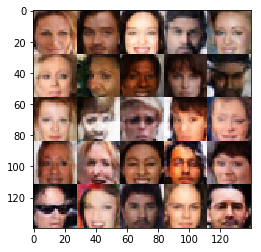

Epoch 5/10 Step 28500... Discriminator Loss: 1.4118... Generator Loss: 0.4695 ... Time spent=0.0936
Epoch 5/10 Step 28600... Discriminator Loss: 1.3525... Generator Loss: 0.6246 ... Time spent=0.0870


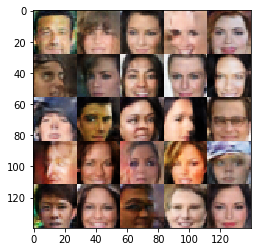

Epoch 5/10 Step 28700... Discriminator Loss: 1.2380... Generator Loss: 0.6180 ... Time spent=0.0876
Epoch 5/10 Step 28800... Discriminator Loss: 1.3415... Generator Loss: 0.5550 ... Time spent=0.0891


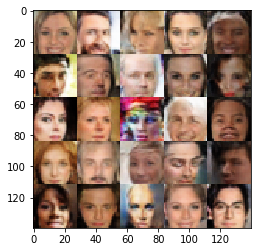

Epoch 5/10 Step 28900... Discriminator Loss: 1.4014... Generator Loss: 0.4636 ... Time spent=0.0884
Epoch 5/10 Step 29000... Discriminator Loss: 1.4273... Generator Loss: 0.4655 ... Time spent=0.0891


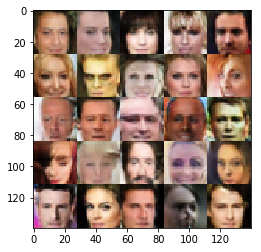

Epoch 5/10 Step 29100... Discriminator Loss: 1.5470... Generator Loss: 0.3867 ... Time spent=0.0872
Epoch 5/10 Step 29200... Discriminator Loss: 1.1796... Generator Loss: 0.7022 ... Time spent=0.0894


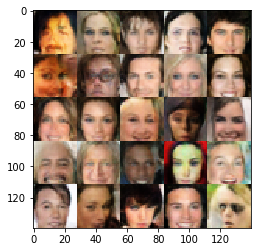

Epoch 5/10 Step 29300... Discriminator Loss: 1.3178... Generator Loss: 0.6108 ... Time spent=0.0891
Epoch 5/10 Step 29400... Discriminator Loss: 1.1577... Generator Loss: 0.6802 ... Time spent=0.0891


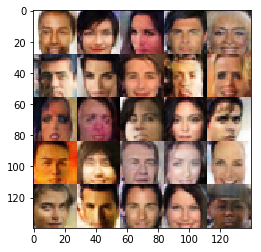

Epoch 5/10 Step 29500... Discriminator Loss: 1.2119... Generator Loss: 0.7834 ... Time spent=0.0864
Epoch 5/10 Step 29600... Discriminator Loss: 1.5708... Generator Loss: 0.4151 ... Time spent=0.0897


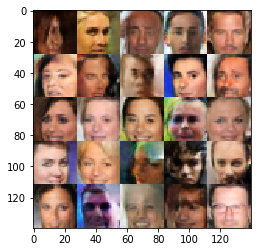

Epoch 5/10 Step 29700... Discriminator Loss: 1.4007... Generator Loss: 0.4851 ... Time spent=0.0890
Epoch 5/10 Step 29800... Discriminator Loss: 1.3620... Generator Loss: 0.4770 ... Time spent=0.0883


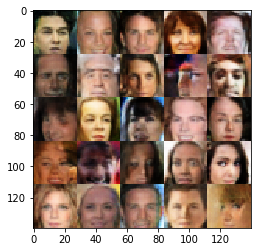

Epoch 5/10 Step 29900... Discriminator Loss: 1.4029... Generator Loss: 0.4994 ... Time spent=0.0909
Epoch 5/10 Step 30000... Discriminator Loss: 1.4176... Generator Loss: 0.4496 ... Time spent=0.0886


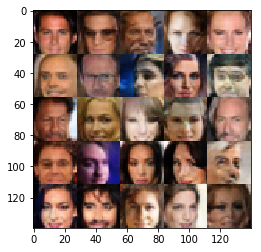

Epoch 5/10 Step 30100... Discriminator Loss: 1.3852... Generator Loss: 0.4992 ... Time spent=0.0890
Epoch 5/10 Step 30200... Discriminator Loss: 1.2795... Generator Loss: 0.5622 ... Time spent=0.0879


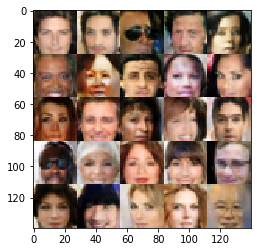

Epoch 5/10 Step 30300... Discriminator Loss: 1.4144... Generator Loss: 0.4673 ... Time spent=0.0878
Epoch 5/10 Step 30400... Discriminator Loss: 1.2138... Generator Loss: 0.6863 ... Time spent=0.0908


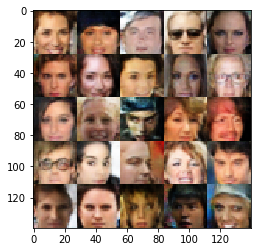

Epoch 5/10 Step 30500... Discriminator Loss: 1.2129... Generator Loss: 0.6737 ... Time spent=0.0891
Epoch 5/10 Step 30600... Discriminator Loss: 1.2334... Generator Loss: 0.6576 ... Time spent=0.0880


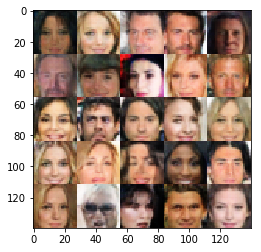

Epoch 5/10 Step 30700... Discriminator Loss: 1.3244... Generator Loss: 0.6059 ... Time spent=0.0888
Epoch 5/10 Step 30800... Discriminator Loss: 1.2387... Generator Loss: 0.8483 ... Time spent=0.0894


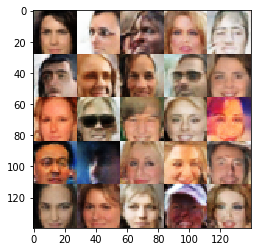

Epoch 5/10 Step 30900... Discriminator Loss: 1.1922... Generator Loss: 0.7062 ... Time spent=0.0888
Epoch 5/10 Step 31000... Discriminator Loss: 1.5261... Generator Loss: 0.4467 ... Time spent=0.0883


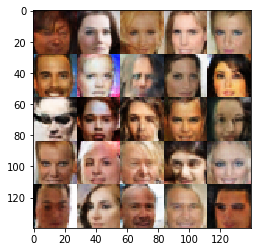

Epoch 5/10 Step 31100... Discriminator Loss: 1.3139... Generator Loss: 0.5393 ... Time spent=0.0879
Epoch 5/10 Step 31200... Discriminator Loss: 1.3668... Generator Loss: 0.5080 ... Time spent=0.0907


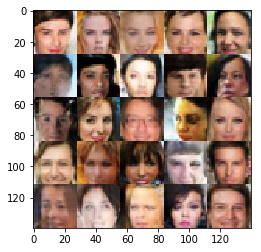

Epoch 5/10 Step 31300... Discriminator Loss: 1.3334... Generator Loss: 0.5207 ... Time spent=0.0895
Epoch 5/10 Step 31400... Discriminator Loss: 1.0923... Generator Loss: 0.7743 ... Time spent=0.0873


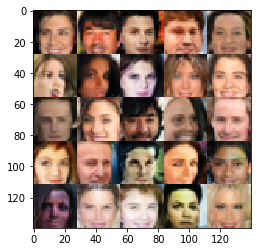

Epoch 5/10 Step 31500... Discriminator Loss: 1.4235... Generator Loss: 0.4580 ... Time spent=0.0872
Epoch 5/10 Step 31600... Discriminator Loss: 1.3760... Generator Loss: 0.4900 ... Time spent=0.0907


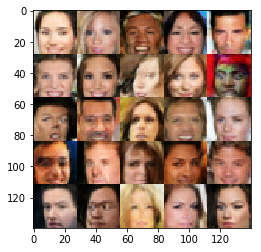

Epoch 6/10 Step 31700... Discriminator Loss: 1.0592... Generator Loss: 0.8867 ... Time spent=0.0886
Epoch 6/10 Step 31800... Discriminator Loss: 1.1828... Generator Loss: 0.8906 ... Time spent=0.0875


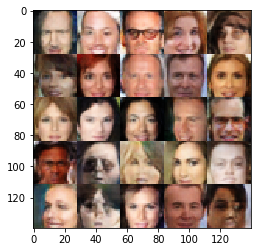

Epoch 6/10 Step 31900... Discriminator Loss: 1.2236... Generator Loss: 0.6165 ... Time spent=0.0875
Epoch 6/10 Step 32000... Discriminator Loss: 1.2672... Generator Loss: 0.6997 ... Time spent=0.0882


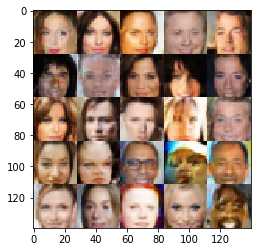

Epoch 6/10 Step 32100... Discriminator Loss: 1.2445... Generator Loss: 0.6151 ... Time spent=0.0887
Epoch 6/10 Step 32200... Discriminator Loss: 1.3341... Generator Loss: 0.6668 ... Time spent=0.0881


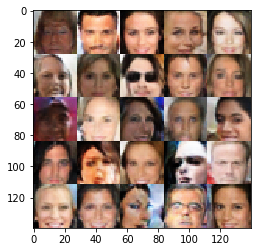

Epoch 6/10 Step 32300... Discriminator Loss: 1.1598... Generator Loss: 0.6889 ... Time spent=0.0901
Epoch 6/10 Step 32400... Discriminator Loss: 1.2936... Generator Loss: 0.5220 ... Time spent=0.0933


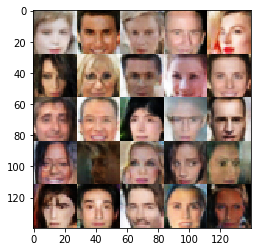

Epoch 6/10 Step 32500... Discriminator Loss: 1.2517... Generator Loss: 0.6511 ... Time spent=0.0877
Epoch 6/10 Step 32600... Discriminator Loss: 1.3912... Generator Loss: 0.4881 ... Time spent=0.0879


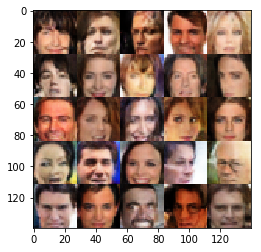

Epoch 6/10 Step 32700... Discriminator Loss: 1.0684... Generator Loss: 0.7668 ... Time spent=0.0872
Epoch 6/10 Step 32800... Discriminator Loss: 1.3691... Generator Loss: 0.5459 ... Time spent=0.0901


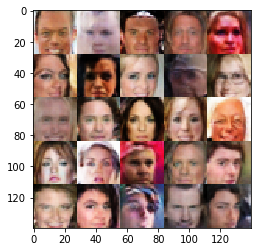

Epoch 6/10 Step 32900... Discriminator Loss: 0.8799... Generator Loss: 1.2827 ... Time spent=0.0893
Epoch 6/10 Step 33000... Discriminator Loss: 1.5345... Generator Loss: 0.3991 ... Time spent=0.0901


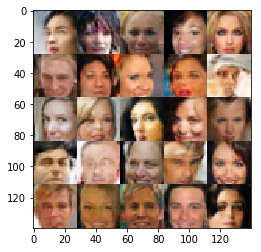

Epoch 6/10 Step 33100... Discriminator Loss: 1.3031... Generator Loss: 0.8317 ... Time spent=0.0898
Epoch 6/10 Step 33200... Discriminator Loss: 1.1350... Generator Loss: 0.7933 ... Time spent=0.0871


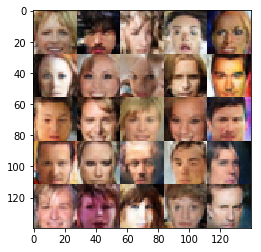

Epoch 6/10 Step 33300... Discriminator Loss: 1.3864... Generator Loss: 0.7270 ... Time spent=0.0890
Epoch 6/10 Step 33400... Discriminator Loss: 1.3236... Generator Loss: 0.5377 ... Time spent=0.0899


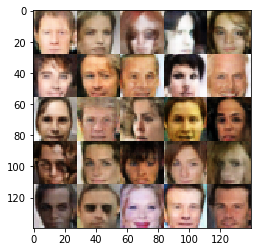

Epoch 6/10 Step 33500... Discriminator Loss: 1.3743... Generator Loss: 0.4799 ... Time spent=0.0885
Epoch 6/10 Step 33600... Discriminator Loss: 1.0811... Generator Loss: 0.7651 ... Time spent=0.0870


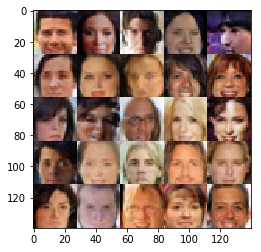

Epoch 6/10 Step 33700... Discriminator Loss: 1.3645... Generator Loss: 0.5593 ... Time spent=0.0888
Epoch 6/10 Step 33800... Discriminator Loss: 1.2645... Generator Loss: 0.5742 ... Time spent=0.0908


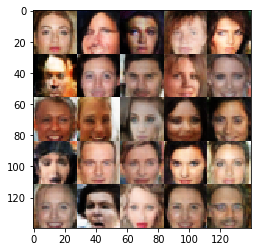

Epoch 6/10 Step 33900... Discriminator Loss: 1.3063... Generator Loss: 0.5842 ... Time spent=0.0878
Epoch 6/10 Step 34000... Discriminator Loss: 1.2044... Generator Loss: 0.6464 ... Time spent=0.0876


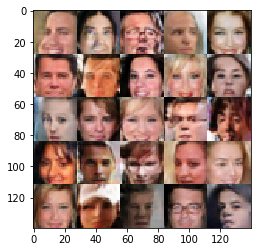

Epoch 6/10 Step 34100... Discriminator Loss: 1.3686... Generator Loss: 0.4853 ... Time spent=0.0885
Epoch 6/10 Step 34200... Discriminator Loss: 1.3867... Generator Loss: 0.5074 ... Time spent=0.0890


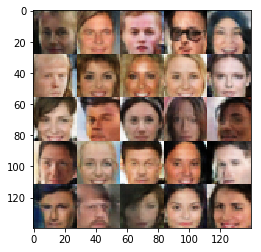

Epoch 6/10 Step 34300... Discriminator Loss: 1.2584... Generator Loss: 0.5662 ... Time spent=0.0878
Epoch 6/10 Step 34400... Discriminator Loss: 1.4884... Generator Loss: 0.4154 ... Time spent=0.0897


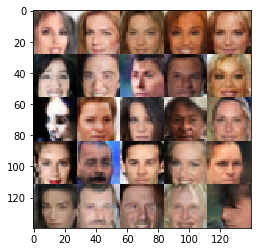

Epoch 6/10 Step 34500... Discriminator Loss: 1.2524... Generator Loss: 0.6042 ... Time spent=0.0886
Epoch 6/10 Step 34600... Discriminator Loss: 1.3701... Generator Loss: 0.4789 ... Time spent=0.0894


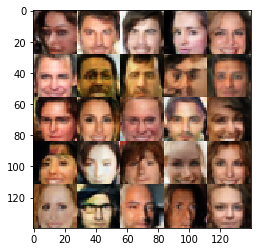

Epoch 6/10 Step 34700... Discriminator Loss: 1.2495... Generator Loss: 0.7199 ... Time spent=0.0886
Epoch 6/10 Step 34800... Discriminator Loss: 1.3789... Generator Loss: 0.5052 ... Time spent=0.0904


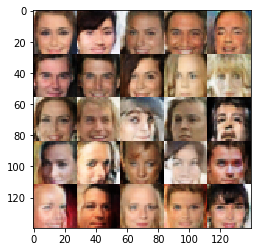

Epoch 6/10 Step 34900... Discriminator Loss: 1.1649... Generator Loss: 0.7198 ... Time spent=0.0911
Epoch 6/10 Step 35000... Discriminator Loss: 1.0399... Generator Loss: 0.8255 ... Time spent=0.0877


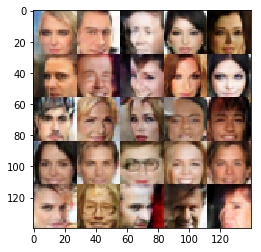

Epoch 6/10 Step 35100... Discriminator Loss: 1.2684... Generator Loss: 0.6271 ... Time spent=0.0900
Epoch 6/10 Step 35200... Discriminator Loss: 1.2634... Generator Loss: 0.6299 ... Time spent=0.0888


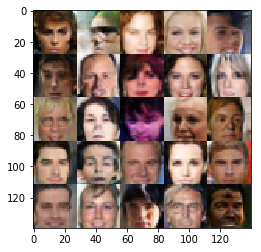

Epoch 6/10 Step 35300... Discriminator Loss: 1.0463... Generator Loss: 0.8981 ... Time spent=0.0883
Epoch 6/10 Step 35400... Discriminator Loss: 1.4073... Generator Loss: 0.5547 ... Time spent=0.0882


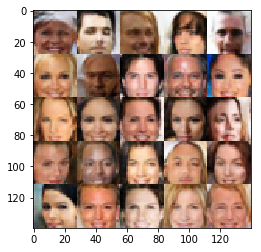

Epoch 6/10 Step 35500... Discriminator Loss: 1.5851... Generator Loss: 0.3609 ... Time spent=0.0881
Epoch 6/10 Step 35600... Discriminator Loss: 1.3583... Generator Loss: 0.4839 ... Time spent=0.0889


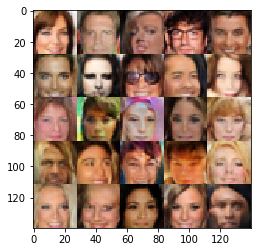

Epoch 6/10 Step 35700... Discriminator Loss: 1.0281... Generator Loss: 0.8446 ... Time spent=0.0881
Epoch 6/10 Step 35800... Discriminator Loss: 1.0340... Generator Loss: 1.2292 ... Time spent=0.0889


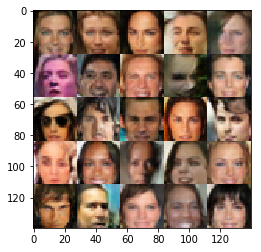

Epoch 6/10 Step 35900... Discriminator Loss: 1.5670... Generator Loss: 0.3817 ... Time spent=0.0903
Epoch 6/10 Step 36000... Discriminator Loss: 1.6523... Generator Loss: 0.3455 ... Time spent=0.0893


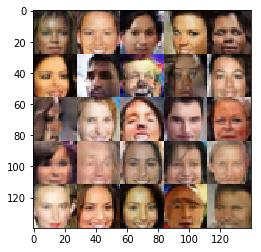

Epoch 6/10 Step 36100... Discriminator Loss: 1.4320... Generator Loss: 0.4375 ... Time spent=0.0896
Epoch 6/10 Step 36200... Discriminator Loss: 1.2404... Generator Loss: 0.6137 ... Time spent=0.0896


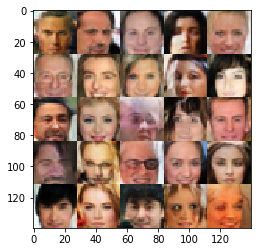

Epoch 6/10 Step 36300... Discriminator Loss: 1.1545... Generator Loss: 0.8447 ... Time spent=0.0893
Epoch 6/10 Step 36400... Discriminator Loss: 1.3305... Generator Loss: 0.5305 ... Time spent=0.0912


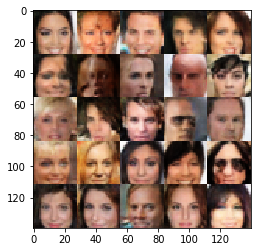

Epoch 6/10 Step 36500... Discriminator Loss: 0.9753... Generator Loss: 1.1222 ... Time spent=0.0886
Epoch 6/10 Step 36600... Discriminator Loss: 1.2338... Generator Loss: 0.6336 ... Time spent=0.0898


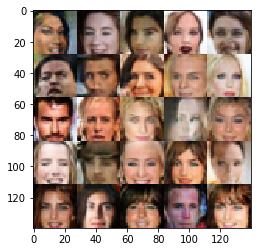

Epoch 6/10 Step 36700... Discriminator Loss: 1.1651... Generator Loss: 0.6799 ... Time spent=0.0905
Epoch 6/10 Step 36800... Discriminator Loss: 1.6498... Generator Loss: 0.3399 ... Time spent=0.0905


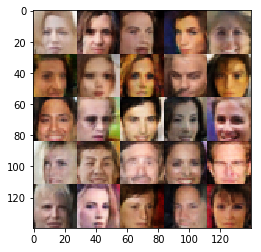

Epoch 6/10 Step 36900... Discriminator Loss: 1.3629... Generator Loss: 0.4625 ... Time spent=0.0885
Epoch 6/10 Step 37000... Discriminator Loss: 0.9388... Generator Loss: 1.0770 ... Time spent=0.0896


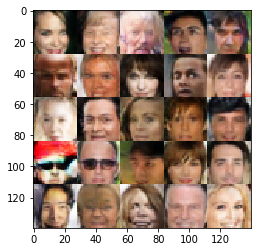

Epoch 6/10 Step 37100... Discriminator Loss: 1.1324... Generator Loss: 0.7504 ... Time spent=0.0900
Epoch 6/10 Step 37200... Discriminator Loss: 1.1341... Generator Loss: 0.7331 ... Time spent=0.0901


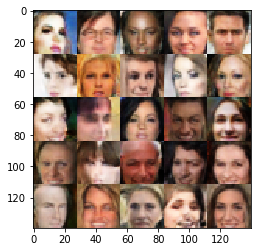

Epoch 6/10 Step 37300... Discriminator Loss: 1.3449... Generator Loss: 0.4976 ... Time spent=0.0884
Epoch 6/10 Step 37400... Discriminator Loss: 1.2014... Generator Loss: 0.7385 ... Time spent=0.0895


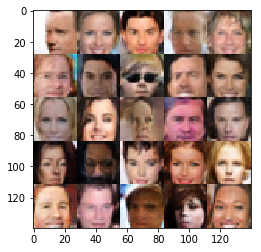

Epoch 6/10 Step 37500... Discriminator Loss: 1.6448... Generator Loss: 0.3566 ... Time spent=0.0894
Epoch 6/10 Step 37600... Discriminator Loss: 1.2149... Generator Loss: 0.7208 ... Time spent=0.0890


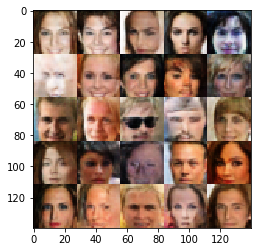

Epoch 6/10 Step 37700... Discriminator Loss: 1.2311... Generator Loss: 0.6364 ... Time spent=0.0904
Epoch 6/10 Step 37800... Discriminator Loss: 1.2692... Generator Loss: 0.5205 ... Time spent=0.0902


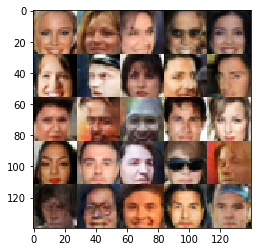

Epoch 6/10 Step 37900... Discriminator Loss: 1.5126... Generator Loss: 0.4094 ... Time spent=0.0900
Epoch 7/10 Step 38000... Discriminator Loss: 1.3108... Generator Loss: 0.5187 ... Time spent=0.0895


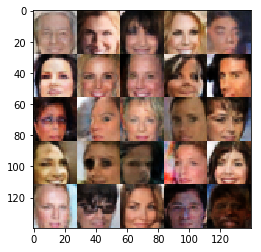

Epoch 7/10 Step 38100... Discriminator Loss: 1.3892... Generator Loss: 0.4885 ... Time spent=0.0887
Epoch 7/10 Step 38200... Discriminator Loss: 1.3148... Generator Loss: 0.6429 ... Time spent=0.0893


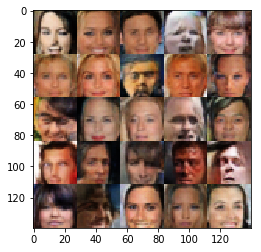

Epoch 7/10 Step 38300... Discriminator Loss: 1.3764... Generator Loss: 0.5009 ... Time spent=0.0924
Epoch 7/10 Step 38400... Discriminator Loss: 1.1213... Generator Loss: 0.6887 ... Time spent=0.0894


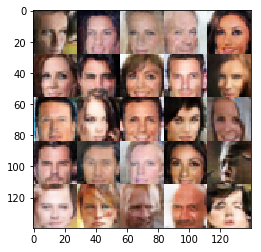

Epoch 7/10 Step 38500... Discriminator Loss: 1.2096... Generator Loss: 0.5896 ... Time spent=0.0888
Epoch 7/10 Step 38600... Discriminator Loss: 1.2339... Generator Loss: 0.7428 ... Time spent=0.0892


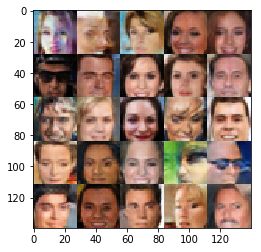

Epoch 7/10 Step 38700... Discriminator Loss: 0.9240... Generator Loss: 1.0745 ... Time spent=0.0903
Epoch 7/10 Step 38800... Discriminator Loss: 1.5341... Generator Loss: 0.3843 ... Time spent=0.0881


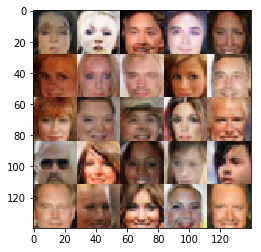

Epoch 7/10 Step 38900... Discriminator Loss: 1.2625... Generator Loss: 0.6421 ... Time spent=0.0883
Epoch 7/10 Step 39000... Discriminator Loss: 1.1872... Generator Loss: 0.6281 ... Time spent=0.0898


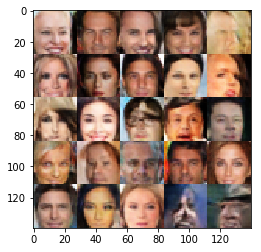

Epoch 7/10 Step 39100... Discriminator Loss: 1.2925... Generator Loss: 0.6498 ... Time spent=0.0889
Epoch 7/10 Step 39200... Discriminator Loss: 1.2552... Generator Loss: 0.5769 ... Time spent=0.0933


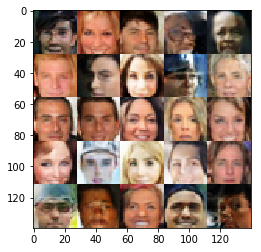

Epoch 7/10 Step 39300... Discriminator Loss: 1.6736... Generator Loss: 0.3380 ... Time spent=0.0896
Epoch 7/10 Step 39400... Discriminator Loss: 1.2854... Generator Loss: 0.5454 ... Time spent=0.0886


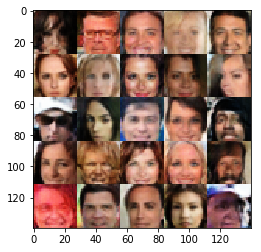

Epoch 7/10 Step 39500... Discriminator Loss: 1.3477... Generator Loss: 0.4895 ... Time spent=0.0892
Epoch 7/10 Step 39600... Discriminator Loss: 1.2412... Generator Loss: 0.5783 ... Time spent=0.0889


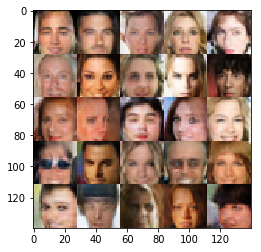

Epoch 7/10 Step 39700... Discriminator Loss: 1.5650... Generator Loss: 0.3900 ... Time spent=0.0889
Epoch 7/10 Step 39800... Discriminator Loss: 1.1909... Generator Loss: 0.8443 ... Time spent=0.0897


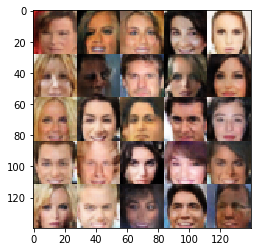

Epoch 7/10 Step 39900... Discriminator Loss: 1.1450... Generator Loss: 0.7777 ... Time spent=0.0895
Epoch 7/10 Step 40000... Discriminator Loss: 1.3676... Generator Loss: 0.5363 ... Time spent=0.0879


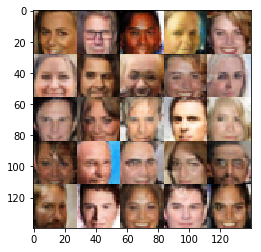

Epoch 7/10 Step 40100... Discriminator Loss: 1.2389... Generator Loss: 0.6202 ... Time spent=0.0868
Epoch 7/10 Step 40200... Discriminator Loss: 1.1915... Generator Loss: 0.7141 ... Time spent=0.0893


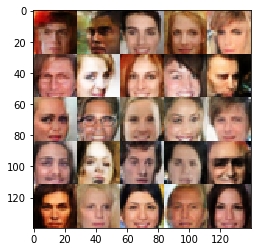

Epoch 7/10 Step 40300... Discriminator Loss: 1.2367... Generator Loss: 0.6294 ... Time spent=0.0872
Epoch 7/10 Step 40400... Discriminator Loss: 0.9988... Generator Loss: 0.8795 ... Time spent=0.0883


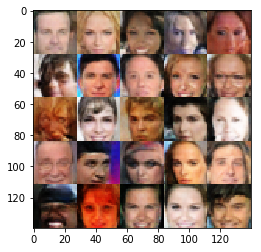

Epoch 7/10 Step 40500... Discriminator Loss: 1.3944... Generator Loss: 0.4703 ... Time spent=0.0907
Epoch 7/10 Step 40600... Discriminator Loss: 1.1931... Generator Loss: 0.7003 ... Time spent=0.0890


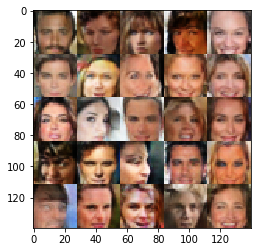

Epoch 7/10 Step 40700... Discriminator Loss: 1.2757... Generator Loss: 0.5471 ... Time spent=0.0886
Epoch 7/10 Step 40800... Discriminator Loss: 1.2092... Generator Loss: 0.7030 ... Time spent=0.0908


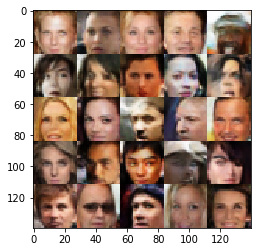

Epoch 7/10 Step 40900... Discriminator Loss: 1.1963... Generator Loss: 0.7325 ... Time spent=0.0889
Epoch 7/10 Step 41000... Discriminator Loss: 1.2255... Generator Loss: 0.7326 ... Time spent=0.0902


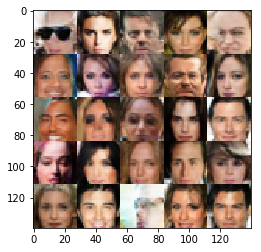

Epoch 7/10 Step 41100... Discriminator Loss: 1.5762... Generator Loss: 0.3918 ... Time spent=0.0892
Epoch 7/10 Step 41200... Discriminator Loss: 1.0598... Generator Loss: 0.9042 ... Time spent=0.0888


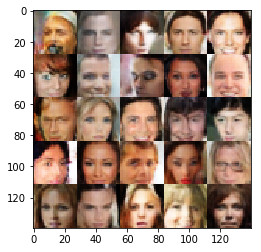

Epoch 7/10 Step 41300... Discriminator Loss: 0.9216... Generator Loss: 1.4611 ... Time spent=0.0889
Epoch 7/10 Step 41400... Discriminator Loss: 1.3952... Generator Loss: 0.4719 ... Time spent=0.0891


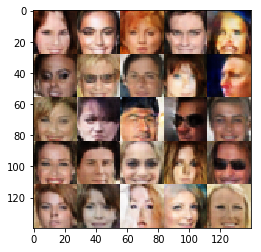

Epoch 7/10 Step 41500... Discriminator Loss: 1.1169... Generator Loss: 0.7245 ... Time spent=0.0872
Epoch 7/10 Step 41600... Discriminator Loss: 1.1727... Generator Loss: 0.6834 ... Time spent=0.0902


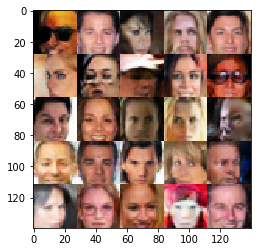

Epoch 7/10 Step 41700... Discriminator Loss: 1.1426... Generator Loss: 0.7070 ... Time spent=0.0873
Epoch 7/10 Step 41800... Discriminator Loss: 1.2513... Generator Loss: 0.8508 ... Time spent=0.0886


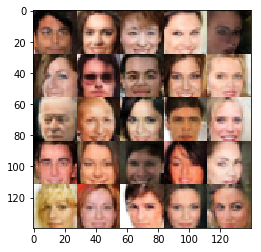

Epoch 7/10 Step 41900... Discriminator Loss: 1.2945... Generator Loss: 0.5237 ... Time spent=0.0883
Epoch 7/10 Step 42000... Discriminator Loss: 1.2824... Generator Loss: 0.5624 ... Time spent=0.0910


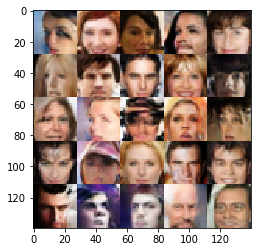

Epoch 7/10 Step 42100... Discriminator Loss: 1.5637... Generator Loss: 0.3767 ... Time spent=0.0885
Epoch 7/10 Step 42200... Discriminator Loss: 1.0886... Generator Loss: 0.8065 ... Time spent=0.0885


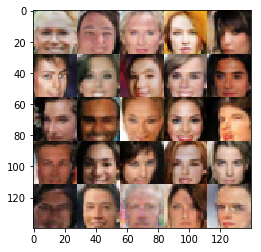

Epoch 7/10 Step 42300... Discriminator Loss: 0.9974... Generator Loss: 0.8854 ... Time spent=0.0900
Epoch 7/10 Step 42400... Discriminator Loss: 0.9995... Generator Loss: 0.9720 ... Time spent=0.0905


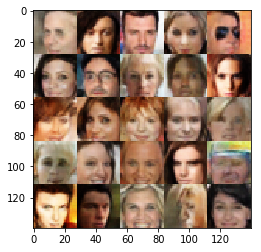

Epoch 7/10 Step 42500... Discriminator Loss: 1.3441... Generator Loss: 1.1062 ... Time spent=0.0887
Epoch 7/10 Step 42600... Discriminator Loss: 1.5788... Generator Loss: 0.3714 ... Time spent=0.0881


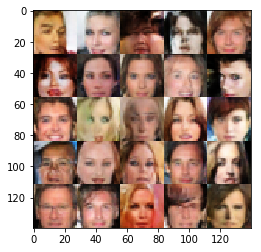

Epoch 7/10 Step 42700... Discriminator Loss: 1.2598... Generator Loss: 0.6784 ... Time spent=0.0893
Epoch 7/10 Step 42800... Discriminator Loss: 1.1936... Generator Loss: 0.6807 ... Time spent=0.0895


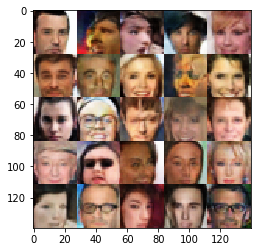

Epoch 7/10 Step 42900... Discriminator Loss: 1.2680... Generator Loss: 0.6423 ... Time spent=0.0893
Epoch 7/10 Step 43000... Discriminator Loss: 1.2485... Generator Loss: 0.5746 ... Time spent=0.0884


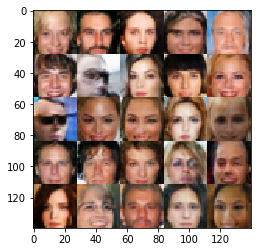

Epoch 7/10 Step 43100... Discriminator Loss: 1.3874... Generator Loss: 0.5434 ... Time spent=0.0902
Epoch 7/10 Step 43200... Discriminator Loss: 1.0922... Generator Loss: 0.7539 ... Time spent=0.0893


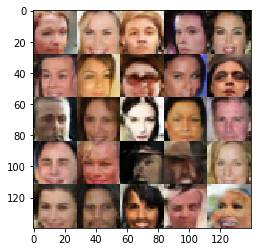

Epoch 7/10 Step 43300... Discriminator Loss: 1.3047... Generator Loss: 0.5449 ... Time spent=0.0896
Epoch 7/10 Step 43400... Discriminator Loss: 1.4315... Generator Loss: 0.4308 ... Time spent=0.0902


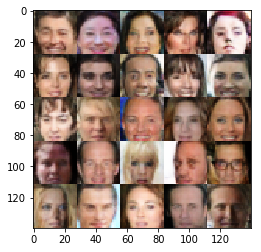

Epoch 7/10 Step 43500... Discriminator Loss: 1.3234... Generator Loss: 0.5755 ... Time spent=0.0886
Epoch 7/10 Step 43600... Discriminator Loss: 1.0969... Generator Loss: 0.8421 ... Time spent=0.0891


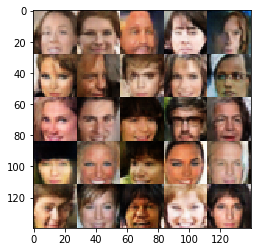

Epoch 7/10 Step 43700... Discriminator Loss: 1.3278... Generator Loss: 0.5402 ... Time spent=0.0898
Epoch 7/10 Step 43800... Discriminator Loss: 1.3215... Generator Loss: 0.4978 ... Time spent=0.0895


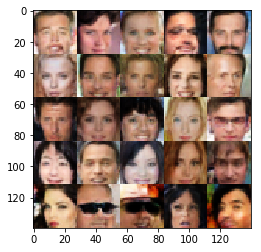

Epoch 7/10 Step 43900... Discriminator Loss: 1.2623... Generator Loss: 0.5474 ... Time spent=0.0903
Epoch 7/10 Step 44000... Discriminator Loss: 0.9900... Generator Loss: 0.9539 ... Time spent=0.0880


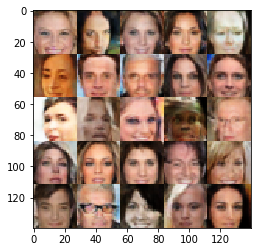

Epoch 7/10 Step 44100... Discriminator Loss: 1.4511... Generator Loss: 0.5078 ... Time spent=0.0901
Epoch 7/10 Step 44200... Discriminator Loss: 1.1097... Generator Loss: 0.7447 ... Time spent=0.0889


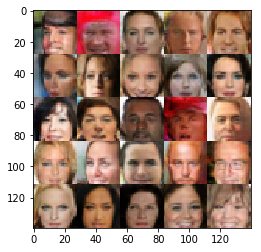

Epoch 7/10 Step 44300... Discriminator Loss: 1.4637... Generator Loss: 0.6486 ... Time spent=0.0899
Epoch 8/10 Step 44400... Discriminator Loss: 1.1003... Generator Loss: 0.7797 ... Time spent=0.0901


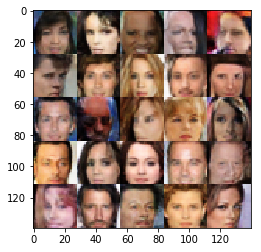

Epoch 8/10 Step 44500... Discriminator Loss: 1.7150... Generator Loss: 0.3225 ... Time spent=0.0886
Epoch 8/10 Step 44600... Discriminator Loss: 1.0624... Generator Loss: 0.7400 ... Time spent=0.0899


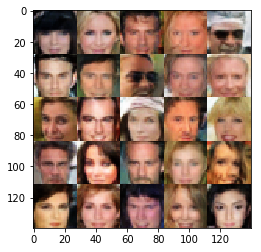

Epoch 8/10 Step 44700... Discriminator Loss: 1.1220... Generator Loss: 0.7401 ... Time spent=0.0909
Epoch 8/10 Step 44800... Discriminator Loss: 1.2628... Generator Loss: 0.6014 ... Time spent=0.0889


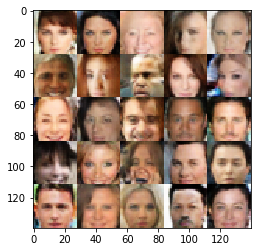

Epoch 8/10 Step 44900... Discriminator Loss: 1.3256... Generator Loss: 0.4997 ... Time spent=0.0897
Epoch 8/10 Step 45000... Discriminator Loss: 1.3333... Generator Loss: 0.5094 ... Time spent=0.0894


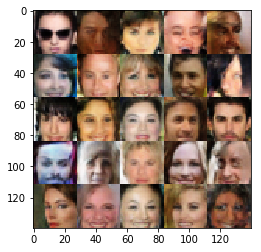

Epoch 8/10 Step 45100... Discriminator Loss: 1.1173... Generator Loss: 0.9247 ... Time spent=0.0882
Epoch 8/10 Step 45200... Discriminator Loss: 1.1645... Generator Loss: 0.6295 ... Time spent=0.0881


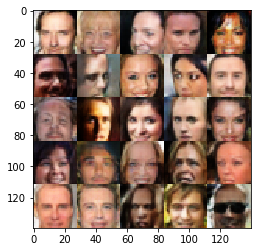

Epoch 8/10 Step 45300... Discriminator Loss: 1.1869... Generator Loss: 0.6097 ... Time spent=0.0895
Epoch 8/10 Step 45400... Discriminator Loss: 1.3047... Generator Loss: 0.5180 ... Time spent=0.0901


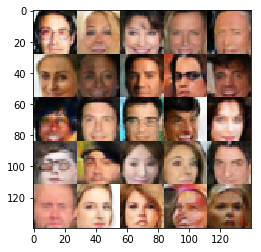

Epoch 8/10 Step 45500... Discriminator Loss: 1.5417... Generator Loss: 0.4098 ... Time spent=0.0863
Epoch 8/10 Step 45600... Discriminator Loss: 1.1429... Generator Loss: 0.7241 ... Time spent=0.0899


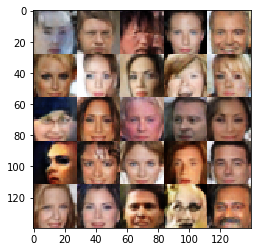

Epoch 8/10 Step 45700... Discriminator Loss: 1.7360... Generator Loss: 0.3526 ... Time spent=0.0871
Epoch 8/10 Step 45800... Discriminator Loss: 1.4393... Generator Loss: 0.4634 ... Time spent=0.0895


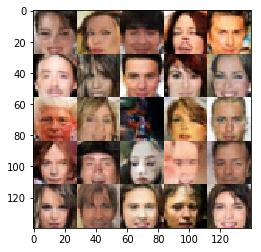

Epoch 8/10 Step 45900... Discriminator Loss: 1.2269... Generator Loss: 0.8434 ... Time spent=0.0890
Epoch 8/10 Step 46000... Discriminator Loss: 1.2198... Generator Loss: 0.6181 ... Time spent=0.0893


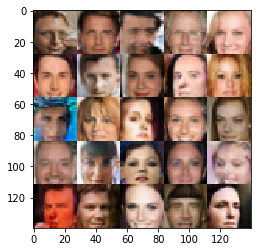

Epoch 8/10 Step 46100... Discriminator Loss: 1.6368... Generator Loss: 0.3408 ... Time spent=0.0898
Epoch 8/10 Step 46200... Discriminator Loss: 1.2017... Generator Loss: 0.6870 ... Time spent=0.0896


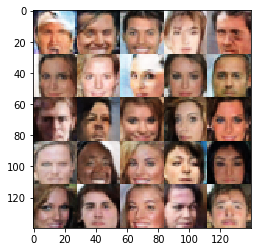

Epoch 8/10 Step 46300... Discriminator Loss: 1.2358... Generator Loss: 0.6273 ... Time spent=0.0892
Epoch 8/10 Step 46400... Discriminator Loss: 1.1307... Generator Loss: 0.7977 ... Time spent=0.0869


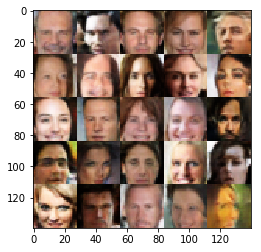

Epoch 8/10 Step 46500... Discriminator Loss: 1.1376... Generator Loss: 0.7342 ... Time spent=0.0886
Epoch 8/10 Step 46600... Discriminator Loss: 1.1218... Generator Loss: 0.6946 ... Time spent=0.0900


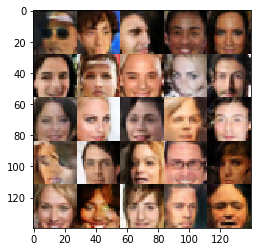

Epoch 8/10 Step 46700... Discriminator Loss: 1.1449... Generator Loss: 0.6962 ... Time spent=0.0904
Epoch 8/10 Step 46800... Discriminator Loss: 1.4337... Generator Loss: 0.4988 ... Time spent=0.0890


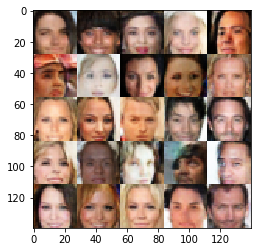

Epoch 8/10 Step 46900... Discriminator Loss: 1.1211... Generator Loss: 1.0666 ... Time spent=0.0882
Epoch 8/10 Step 47000... Discriminator Loss: 1.2764... Generator Loss: 0.5759 ... Time spent=0.0877


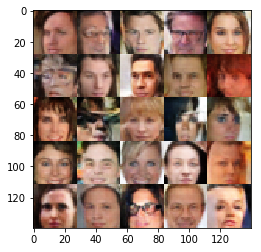

Epoch 8/10 Step 47100... Discriminator Loss: 1.5070... Generator Loss: 0.4071 ... Time spent=0.0882
Epoch 8/10 Step 47200... Discriminator Loss: 1.0245... Generator Loss: 0.8395 ... Time spent=0.0889


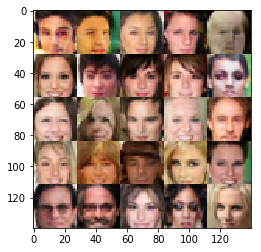

Epoch 8/10 Step 47300... Discriminator Loss: 1.4838... Generator Loss: 0.5488 ... Time spent=0.0906
Epoch 8/10 Step 47400... Discriminator Loss: 1.2117... Generator Loss: 0.6678 ... Time spent=0.0891


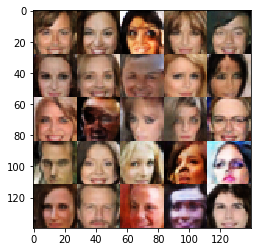

Epoch 8/10 Step 47500... Discriminator Loss: 1.2543... Generator Loss: 0.5692 ... Time spent=0.0909
Epoch 8/10 Step 47600... Discriminator Loss: 1.0978... Generator Loss: 0.7532 ... Time spent=0.0884


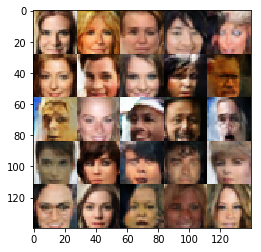

Epoch 8/10 Step 47700... Discriminator Loss: 1.2437... Generator Loss: 0.6856 ... Time spent=0.0895
Epoch 8/10 Step 47800... Discriminator Loss: 1.4236... Generator Loss: 0.4485 ... Time spent=0.0884


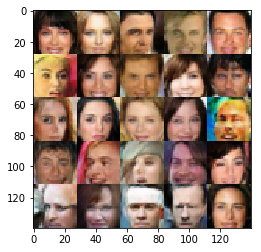

Epoch 8/10 Step 47900... Discriminator Loss: 1.1115... Generator Loss: 0.6797 ... Time spent=0.0883
Epoch 8/10 Step 48000... Discriminator Loss: 1.2343... Generator Loss: 0.6243 ... Time spent=0.0886


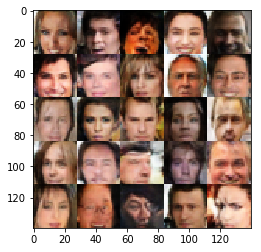

Epoch 8/10 Step 48100... Discriminator Loss: 1.2012... Generator Loss: 0.6171 ... Time spent=0.0864
Epoch 8/10 Step 48200... Discriminator Loss: 1.2308... Generator Loss: 0.6713 ... Time spent=0.0893


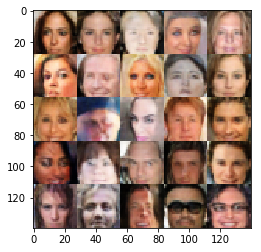

Epoch 8/10 Step 48300... Discriminator Loss: 1.4072... Generator Loss: 0.4675 ... Time spent=0.0899
Epoch 8/10 Step 48400... Discriminator Loss: 1.2977... Generator Loss: 0.7094 ... Time spent=0.0883


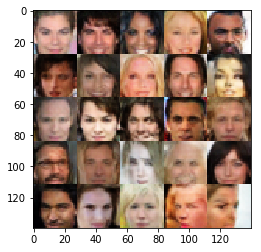

Epoch 8/10 Step 48500... Discriminator Loss: 0.9948... Generator Loss: 0.8897 ... Time spent=0.0881
Epoch 8/10 Step 48600... Discriminator Loss: 1.3835... Generator Loss: 0.4671 ... Time spent=0.0879


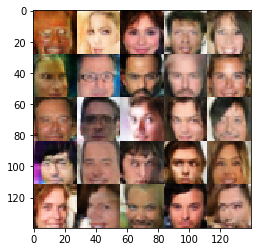

Epoch 8/10 Step 48700... Discriminator Loss: 0.9644... Generator Loss: 0.9772 ... Time spent=0.0875
Epoch 8/10 Step 48800... Discriminator Loss: 1.7547... Generator Loss: 0.3127 ... Time spent=0.0906


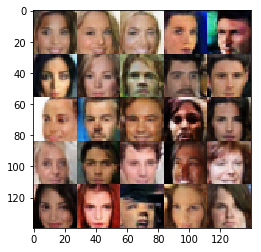

Epoch 8/10 Step 48900... Discriminator Loss: 1.4047... Generator Loss: 0.4520 ... Time spent=0.0872
Epoch 8/10 Step 49000... Discriminator Loss: 0.8106... Generator Loss: 1.5425 ... Time spent=0.0885


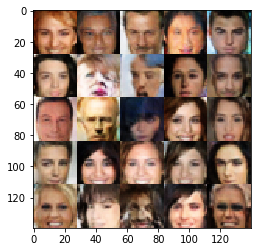

Epoch 8/10 Step 49100... Discriminator Loss: 0.9942... Generator Loss: 0.9338 ... Time spent=0.0893
Epoch 8/10 Step 49200... Discriminator Loss: 1.5105... Generator Loss: 0.3990 ... Time spent=0.0899


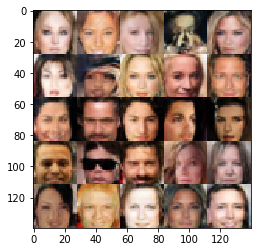

Epoch 8/10 Step 49300... Discriminator Loss: 0.9940... Generator Loss: 0.9547 ... Time spent=0.0898
Epoch 8/10 Step 49400... Discriminator Loss: 1.2505... Generator Loss: 0.7465 ... Time spent=0.0872


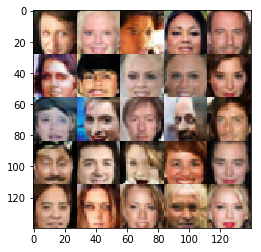

Epoch 8/10 Step 49500... Discriminator Loss: 1.1770... Generator Loss: 0.6479 ... Time spent=0.0885
Epoch 8/10 Step 49600... Discriminator Loss: 1.1623... Generator Loss: 0.7555 ... Time spent=0.0902


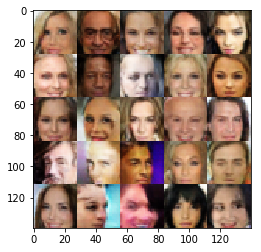

Epoch 8/10 Step 49700... Discriminator Loss: 1.1396... Generator Loss: 0.6902 ... Time spent=0.0891
Epoch 8/10 Step 49800... Discriminator Loss: 1.2023... Generator Loss: 0.6262 ... Time spent=0.0897


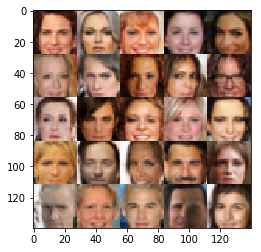

Epoch 8/10 Step 49900... Discriminator Loss: 1.0352... Generator Loss: 0.8854 ... Time spent=0.0889
Epoch 8/10 Step 50000... Discriminator Loss: 1.3218... Generator Loss: 0.5262 ... Time spent=0.0878


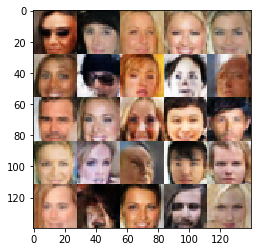

Epoch 8/10 Step 50100... Discriminator Loss: 1.6058... Generator Loss: 0.3740 ... Time spent=0.0890
Epoch 8/10 Step 50200... Discriminator Loss: 0.9199... Generator Loss: 1.0904 ... Time spent=0.0875


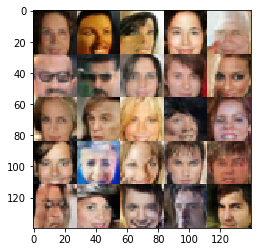

Epoch 8/10 Step 50300... Discriminator Loss: 1.2144... Generator Loss: 0.6114 ... Time spent=0.0873
Epoch 8/10 Step 50400... Discriminator Loss: 1.0828... Generator Loss: 1.2475 ... Time spent=0.0899


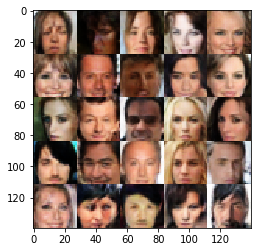

Epoch 8/10 Step 50500... Discriminator Loss: 1.3555... Generator Loss: 0.4973 ... Time spent=0.0893
Epoch 8/10 Step 50600... Discriminator Loss: 1.0468... Generator Loss: 0.9037 ... Time spent=0.0894


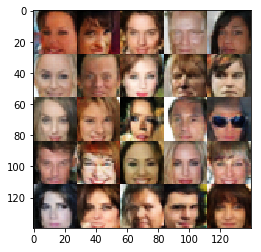

Epoch 9/10 Step 50700... Discriminator Loss: 1.4668... Generator Loss: 0.4579 ... Time spent=0.0903
Epoch 9/10 Step 50800... Discriminator Loss: 1.3183... Generator Loss: 0.6280 ... Time spent=0.0868


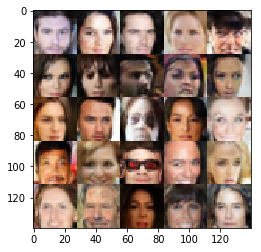

Epoch 9/10 Step 50900... Discriminator Loss: 1.1279... Generator Loss: 0.7640 ... Time spent=0.0898
Epoch 9/10 Step 51000... Discriminator Loss: 1.2163... Generator Loss: 0.5960 ... Time spent=0.0879


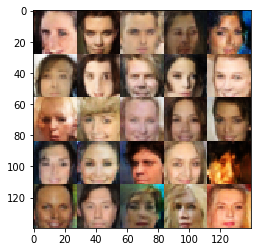

Epoch 9/10 Step 51100... Discriminator Loss: 1.3100... Generator Loss: 0.6232 ... Time spent=0.0888
Epoch 9/10 Step 51200... Discriminator Loss: 0.9576... Generator Loss: 1.1604 ... Time spent=0.0904


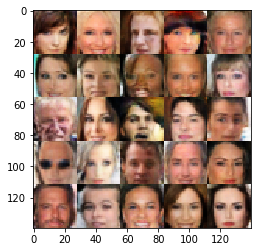

Epoch 9/10 Step 51300... Discriminator Loss: 1.4593... Generator Loss: 0.4386 ... Time spent=0.0898
Epoch 9/10 Step 51400... Discriminator Loss: 1.2849... Generator Loss: 0.5780 ... Time spent=0.0883


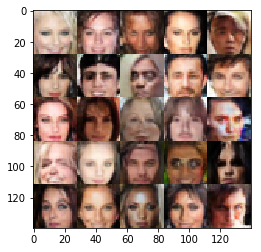

Epoch 9/10 Step 51500... Discriminator Loss: 1.0486... Generator Loss: 0.8864 ... Time spent=0.0869
Epoch 9/10 Step 51600... Discriminator Loss: 0.8685... Generator Loss: 1.2257 ... Time spent=0.0886


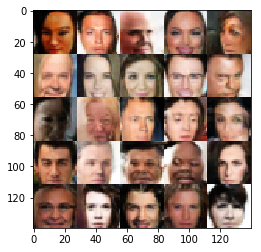

Epoch 9/10 Step 51700... Discriminator Loss: 1.1762... Generator Loss: 0.6521 ... Time spent=0.0901
Epoch 9/10 Step 51800... Discriminator Loss: 1.2834... Generator Loss: 0.8181 ... Time spent=0.0891


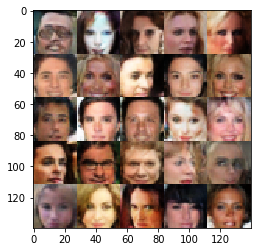

Epoch 9/10 Step 51900... Discriminator Loss: 1.4199... Generator Loss: 0.5540 ... Time spent=0.0881
Epoch 9/10 Step 52000... Discriminator Loss: 1.1242... Generator Loss: 0.8278 ... Time spent=0.0871


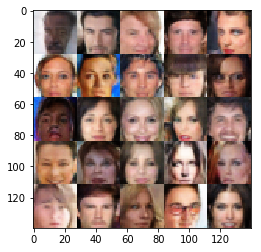

Epoch 9/10 Step 52100... Discriminator Loss: 1.4285... Generator Loss: 0.4425 ... Time spent=0.0880
Epoch 9/10 Step 52200... Discriminator Loss: 1.2162... Generator Loss: 0.7988 ... Time spent=0.0897


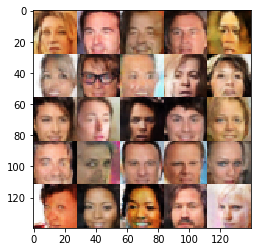

Epoch 9/10 Step 52300... Discriminator Loss: 1.4694... Generator Loss: 0.4190 ... Time spent=0.0903
Epoch 9/10 Step 52400... Discriminator Loss: 1.1484... Generator Loss: 0.7137 ... Time spent=0.0890


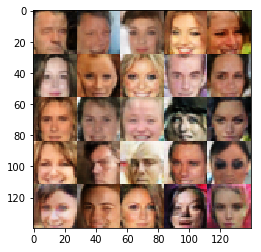

Epoch 9/10 Step 52500... Discriminator Loss: 1.3383... Generator Loss: 0.5844 ... Time spent=0.0883
Epoch 9/10 Step 52600... Discriminator Loss: 1.8155... Generator Loss: 0.2938 ... Time spent=0.0892


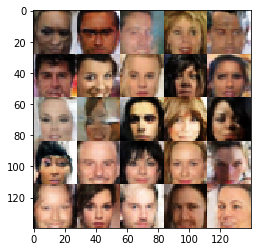

Epoch 9/10 Step 52700... Discriminator Loss: 1.0188... Generator Loss: 0.8598 ... Time spent=0.0890
Epoch 9/10 Step 52800... Discriminator Loss: 1.1736... Generator Loss: 0.6565 ... Time spent=0.0874


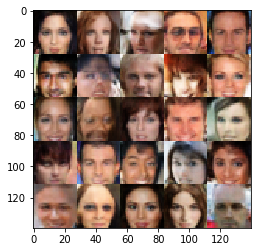

Epoch 9/10 Step 52900... Discriminator Loss: 1.4213... Generator Loss: 0.4778 ... Time spent=0.0900
Epoch 9/10 Step 53000... Discriminator Loss: 0.9310... Generator Loss: 1.0833 ... Time spent=0.0895


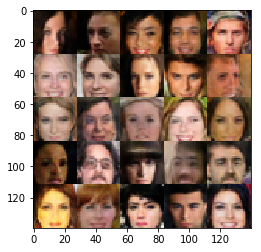

Epoch 9/10 Step 53100... Discriminator Loss: 1.2911... Generator Loss: 0.7039 ... Time spent=0.0890
Epoch 9/10 Step 53200... Discriminator Loss: 1.4057... Generator Loss: 0.4753 ... Time spent=0.0876


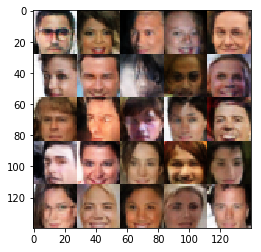

Epoch 9/10 Step 53300... Discriminator Loss: 1.1614... Generator Loss: 0.6923 ... Time spent=0.0880
Epoch 9/10 Step 53400... Discriminator Loss: 0.9324... Generator Loss: 1.1445 ... Time spent=0.0878


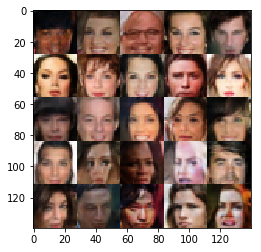

Epoch 9/10 Step 53500... Discriminator Loss: 0.8863... Generator Loss: 1.2935 ... Time spent=0.0888
Epoch 9/10 Step 53600... Discriminator Loss: 1.3089... Generator Loss: 0.5252 ... Time spent=0.0900


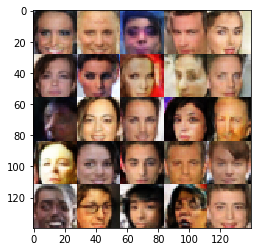

Epoch 9/10 Step 53700... Discriminator Loss: 1.0067... Generator Loss: 0.9883 ... Time spent=0.0887
Epoch 9/10 Step 53800... Discriminator Loss: 1.1000... Generator Loss: 0.7627 ... Time spent=0.0894


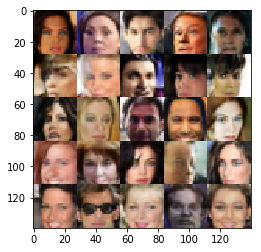

Epoch 9/10 Step 53900... Discriminator Loss: 1.2108... Generator Loss: 0.6126 ... Time spent=0.0882
Epoch 9/10 Step 54000... Discriminator Loss: 1.4926... Generator Loss: 0.4133 ... Time spent=0.0899


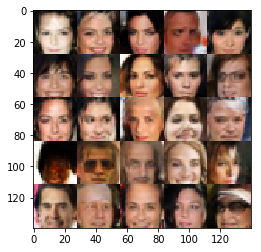

Epoch 9/10 Step 54100... Discriminator Loss: 1.5266... Generator Loss: 0.4485 ... Time spent=0.0900
Epoch 9/10 Step 54200... Discriminator Loss: 1.1617... Generator Loss: 0.6685 ... Time spent=0.0884


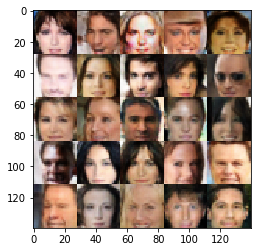

Epoch 9/10 Step 54300... Discriminator Loss: 1.0881... Generator Loss: 0.7023 ... Time spent=0.0903
Epoch 9/10 Step 54400... Discriminator Loss: 1.1797... Generator Loss: 0.6385 ... Time spent=0.0887


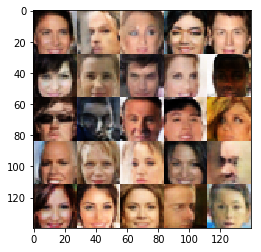

Epoch 9/10 Step 54500... Discriminator Loss: 0.8861... Generator Loss: 1.2223 ... Time spent=0.0891
Epoch 9/10 Step 54600... Discriminator Loss: 1.1786... Generator Loss: 0.6363 ... Time spent=0.0906


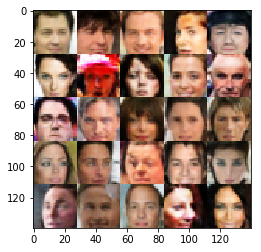

Epoch 9/10 Step 54700... Discriminator Loss: 1.2119... Generator Loss: 0.6051 ... Time spent=0.0872
Epoch 9/10 Step 54800... Discriminator Loss: 1.2815... Generator Loss: 0.6274 ... Time spent=0.0919


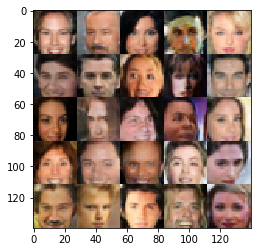

Epoch 9/10 Step 54900... Discriminator Loss: 1.2650... Generator Loss: 0.5709 ... Time spent=0.0896
Epoch 9/10 Step 55000... Discriminator Loss: 1.1417... Generator Loss: 1.0914 ... Time spent=0.0903


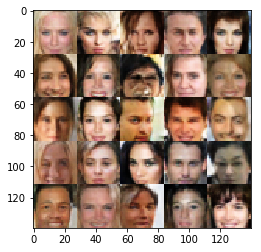

Epoch 9/10 Step 55100... Discriminator Loss: 1.2665... Generator Loss: 0.5825 ... Time spent=0.0892
Epoch 9/10 Step 55200... Discriminator Loss: 0.8828... Generator Loss: 1.3099 ... Time spent=0.0909


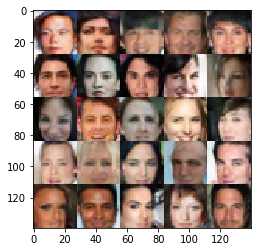

Epoch 9/10 Step 55300... Discriminator Loss: 0.9578... Generator Loss: 1.0623 ... Time spent=0.0887
Epoch 9/10 Step 55400... Discriminator Loss: 1.3069... Generator Loss: 0.5911 ... Time spent=0.0891


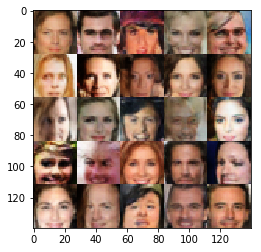

Epoch 9/10 Step 55500... Discriminator Loss: 1.0948... Generator Loss: 0.7712 ... Time spent=0.0890
Epoch 9/10 Step 55600... Discriminator Loss: 1.5847... Generator Loss: 0.3858 ... Time spent=0.0873


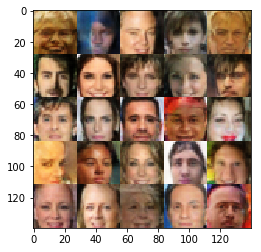

Epoch 9/10 Step 55700... Discriminator Loss: 1.1600... Generator Loss: 0.6989 ... Time spent=0.0914
Epoch 9/10 Step 55800... Discriminator Loss: 1.4015... Generator Loss: 0.4615 ... Time spent=0.0876


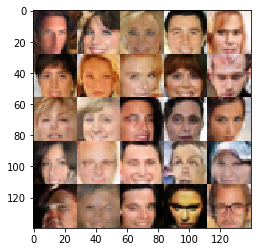

Epoch 9/10 Step 55900... Discriminator Loss: 1.2870... Generator Loss: 0.5427 ... Time spent=0.0920
Epoch 9/10 Step 56000... Discriminator Loss: 1.1208... Generator Loss: 0.7208 ... Time spent=0.0874


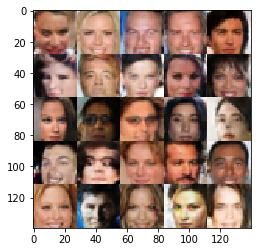

Epoch 9/10 Step 56100... Discriminator Loss: 1.3430... Generator Loss: 0.5158 ... Time spent=0.0891
Epoch 9/10 Step 56200... Discriminator Loss: 1.5587... Generator Loss: 0.3894 ... Time spent=0.0911


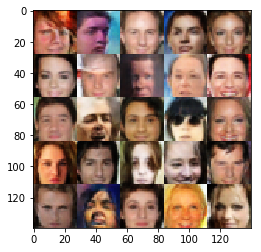

Epoch 9/10 Step 56300... Discriminator Loss: 1.0351... Generator Loss: 0.9496 ... Time spent=0.0901
Epoch 9/10 Step 56400... Discriminator Loss: 0.9189... Generator Loss: 1.0516 ... Time spent=0.0897


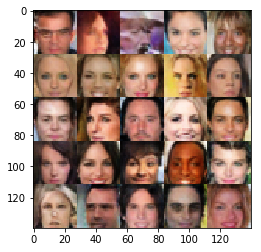

Epoch 9/10 Step 56500... Discriminator Loss: 1.8204... Generator Loss: 0.3429 ... Time spent=0.0891
Epoch 9/10 Step 56600... Discriminator Loss: 1.1941... Generator Loss: 0.6375 ... Time spent=0.0872


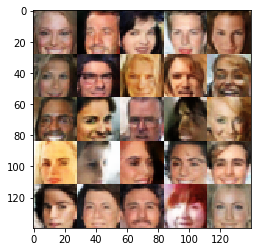

Epoch 9/10 Step 56700... Discriminator Loss: 1.3431... Generator Loss: 0.5268 ... Time spent=0.0887
Epoch 9/10 Step 56800... Discriminator Loss: 0.8973... Generator Loss: 1.1047 ... Time spent=0.0886


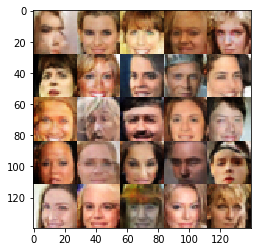

Epoch 9/10 Step 56900... Discriminator Loss: 0.8980... Generator Loss: 1.2367 ... Time spent=0.0870
Epoch 10/10 Step 57000... Discriminator Loss: 1.1336... Generator Loss: 0.7025 ... Time spent=0.0907


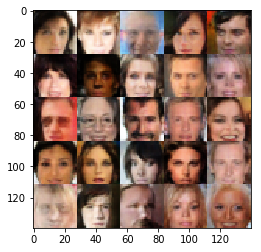

Epoch 10/10 Step 57100... Discriminator Loss: 1.2307... Generator Loss: 0.7527 ... Time spent=0.0899
Epoch 10/10 Step 57200... Discriminator Loss: 1.3862... Generator Loss: 0.5514 ... Time spent=0.0877


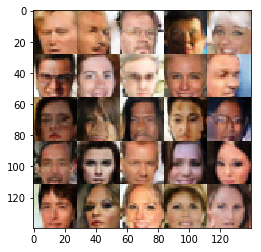

Epoch 10/10 Step 57300... Discriminator Loss: 1.1528... Generator Loss: 0.7889 ... Time spent=0.0891
Epoch 10/10 Step 57400... Discriminator Loss: 1.1960... Generator Loss: 0.6677 ... Time spent=0.0869


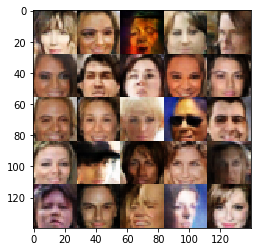

Epoch 10/10 Step 57500... Discriminator Loss: 1.4551... Generator Loss: 0.4297 ... Time spent=0.0896
Epoch 10/10 Step 57600... Discriminator Loss: 1.9850... Generator Loss: 0.2799 ... Time spent=0.0885


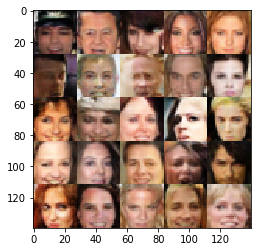

Epoch 10/10 Step 57700... Discriminator Loss: 1.2026... Generator Loss: 0.9086 ... Time spent=0.0890
Epoch 10/10 Step 57800... Discriminator Loss: 1.0043... Generator Loss: 0.9833 ... Time spent=0.0901


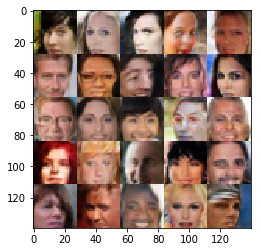

Epoch 10/10 Step 57900... Discriminator Loss: 1.0767... Generator Loss: 0.7683 ... Time spent=0.0889
Epoch 10/10 Step 58000... Discriminator Loss: 1.2353... Generator Loss: 0.6219 ... Time spent=0.0890


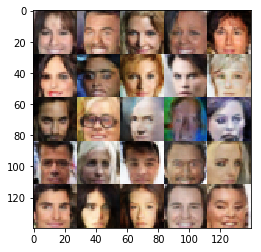

Epoch 10/10 Step 58100... Discriminator Loss: 1.4669... Generator Loss: 0.4280 ... Time spent=0.0898
Epoch 10/10 Step 58200... Discriminator Loss: 1.2577... Generator Loss: 0.5790 ... Time spent=0.0883


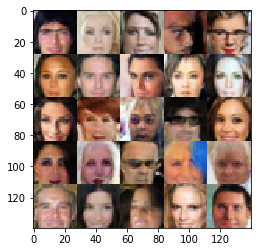

Epoch 10/10 Step 58300... Discriminator Loss: 1.0184... Generator Loss: 0.8480 ... Time spent=0.0871
Epoch 10/10 Step 58400... Discriminator Loss: 1.4660... Generator Loss: 0.4610 ... Time spent=0.0880


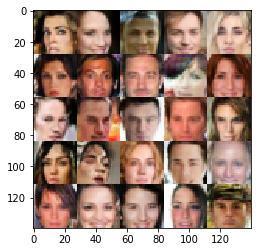

Epoch 10/10 Step 58500... Discriminator Loss: 1.1669... Generator Loss: 0.6615 ... Time spent=0.0884
Epoch 10/10 Step 58600... Discriminator Loss: 1.7476... Generator Loss: 0.3084 ... Time spent=0.0878


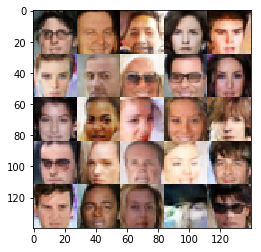

Epoch 10/10 Step 58700... Discriminator Loss: 1.5218... Generator Loss: 0.4209 ... Time spent=0.0878
Epoch 10/10 Step 58800... Discriminator Loss: 1.0719... Generator Loss: 0.8197 ... Time spent=0.0885


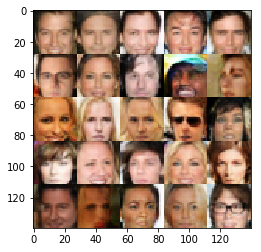

Epoch 10/10 Step 58900... Discriminator Loss: 0.9360... Generator Loss: 0.9943 ... Time spent=0.0875
Epoch 10/10 Step 59000... Discriminator Loss: 1.1036... Generator Loss: 0.7534 ... Time spent=0.0876


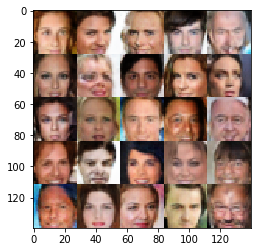

Epoch 10/10 Step 59100... Discriminator Loss: 1.4051... Generator Loss: 0.4672 ... Time spent=0.0880
Epoch 10/10 Step 59200... Discriminator Loss: 1.2142... Generator Loss: 0.6313 ... Time spent=0.0886


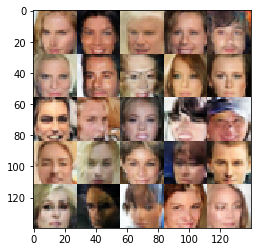

Epoch 10/10 Step 59300... Discriminator Loss: 1.4364... Generator Loss: 0.4415 ... Time spent=0.0881
Epoch 10/10 Step 59400... Discriminator Loss: 1.3029... Generator Loss: 1.0401 ... Time spent=0.0888


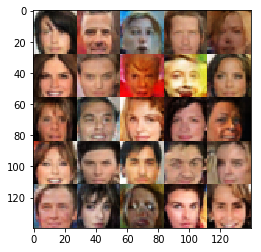

Epoch 10/10 Step 59500... Discriminator Loss: 1.4316... Generator Loss: 0.4798 ... Time spent=0.0874
Epoch 10/10 Step 59600... Discriminator Loss: 1.2724... Generator Loss: 0.6094 ... Time spent=0.0891


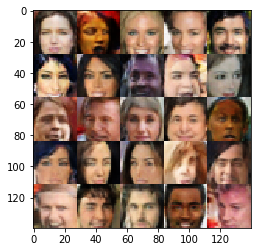

Epoch 10/10 Step 59700... Discriminator Loss: 1.2442... Generator Loss: 0.8886 ... Time spent=0.0870
Epoch 10/10 Step 59800... Discriminator Loss: 1.0548... Generator Loss: 0.7900 ... Time spent=0.0864


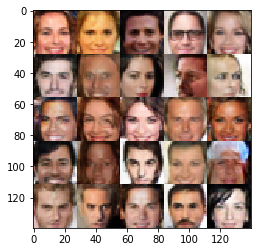

Epoch 10/10 Step 59900... Discriminator Loss: 1.0408... Generator Loss: 0.8876 ... Time spent=0.0896
Epoch 10/10 Step 60000... Discriminator Loss: 1.1924... Generator Loss: 0.6215 ... Time spent=0.0873


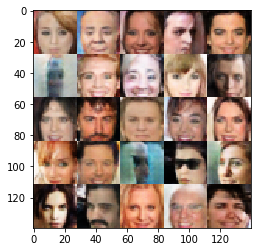

Epoch 10/10 Step 60100... Discriminator Loss: 1.1755... Generator Loss: 0.6797 ... Time spent=0.0895
Epoch 10/10 Step 60200... Discriminator Loss: 1.0671... Generator Loss: 0.7955 ... Time spent=0.0882


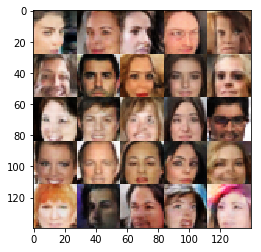

Epoch 10/10 Step 60300... Discriminator Loss: 1.1342... Generator Loss: 0.8959 ... Time spent=0.0884
Epoch 10/10 Step 60400... Discriminator Loss: 1.2447... Generator Loss: 0.6291 ... Time spent=0.0887


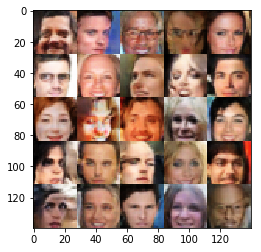

Epoch 10/10 Step 60500... Discriminator Loss: 1.8842... Generator Loss: 0.3107 ... Time spent=0.0887
Epoch 10/10 Step 60600... Discriminator Loss: 1.0660... Generator Loss: 0.9261 ... Time spent=0.0905


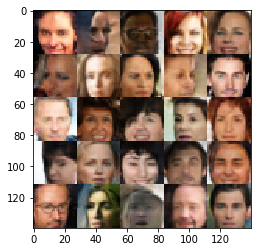

Epoch 10/10 Step 60700... Discriminator Loss: 1.2539... Generator Loss: 0.5940 ... Time spent=0.0886
Epoch 10/10 Step 60800... Discriminator Loss: 1.1521... Generator Loss: 0.7130 ... Time spent=0.0888


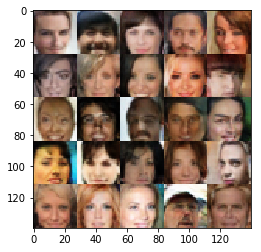

Epoch 10/10 Step 60900... Discriminator Loss: 1.0955... Generator Loss: 0.9720 ... Time spent=0.0883
Epoch 10/10 Step 61000... Discriminator Loss: 1.2966... Generator Loss: 0.5951 ... Time spent=0.0883


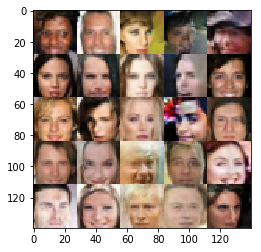

Epoch 10/10 Step 61100... Discriminator Loss: 1.0528... Generator Loss: 0.8752 ... Time spent=0.0886
Epoch 10/10 Step 61200... Discriminator Loss: 1.2557... Generator Loss: 0.6279 ... Time spent=0.0884


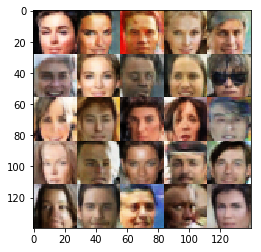

Epoch 10/10 Step 61300... Discriminator Loss: 1.0056... Generator Loss: 0.9809 ... Time spent=0.0881
Epoch 10/10 Step 61400... Discriminator Loss: 1.1170... Generator Loss: 0.7367 ... Time spent=0.0888


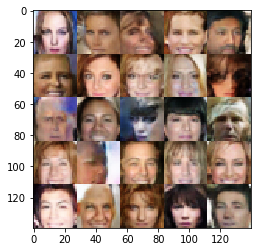

Epoch 10/10 Step 61500... Discriminator Loss: 1.0773... Generator Loss: 0.7685 ... Time spent=0.0885
Epoch 10/10 Step 61600... Discriminator Loss: 0.9423... Generator Loss: 1.0971 ... Time spent=0.0885


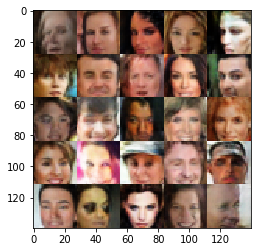

Epoch 10/10 Step 61700... Discriminator Loss: 0.9952... Generator Loss: 0.8344 ... Time spent=0.0887
Epoch 10/10 Step 61800... Discriminator Loss: 1.2210... Generator Loss: 0.7661 ... Time spent=0.0871


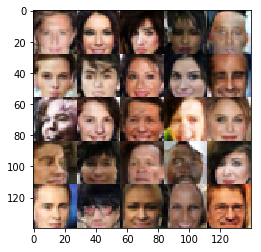

Epoch 10/10 Step 61900... Discriminator Loss: 1.5976... Generator Loss: 0.3848 ... Time spent=0.0883
Epoch 10/10 Step 62000... Discriminator Loss: 0.9853... Generator Loss: 0.9901 ... Time spent=0.0912


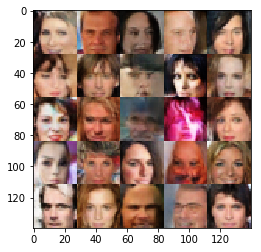

Epoch 10/10 Step 62100... Discriminator Loss: 1.0736... Generator Loss: 0.7251 ... Time spent=0.0899
Epoch 10/10 Step 62200... Discriminator Loss: 1.0194... Generator Loss: 0.9273 ... Time spent=0.0894


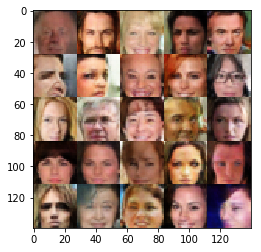

Epoch 10/10 Step 62300... Discriminator Loss: 1.6551... Generator Loss: 0.3717 ... Time spent=0.0897
Epoch 10/10 Step 62400... Discriminator Loss: 1.1403... Generator Loss: 0.9270 ... Time spent=0.0881


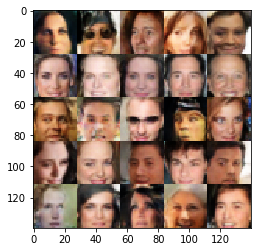

Epoch 10/10 Step 62500... Discriminator Loss: 1.3106... Generator Loss: 0.5526 ... Time spent=0.0886
Epoch 10/10 Step 62600... Discriminator Loss: 1.0691... Generator Loss: 0.7959 ... Time spent=0.0884


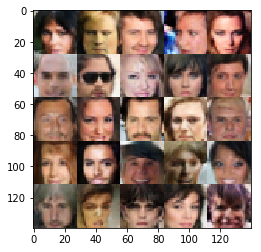

Epoch 10/10 Step 62700... Discriminator Loss: 1.2566... Generator Loss: 0.5754 ... Time spent=0.0890
Epoch 10/10 Step 62800... Discriminator Loss: 1.2037... Generator Loss: 0.8177 ... Time spent=0.0872


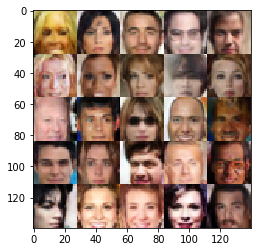

Epoch 10/10 Step 62900... Discriminator Loss: 1.2203... Generator Loss: 0.5854 ... Time spent=0.0904
Epoch 10/10 Step 63000... Discriminator Loss: 1.4267... Generator Loss: 0.4642 ... Time spent=0.0888


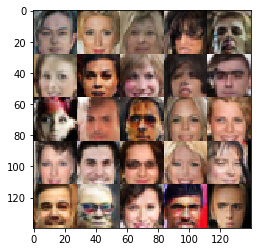

Epoch 10/10 Step 63100... Discriminator Loss: 1.2564... Generator Loss: 0.6314 ... Time spent=0.0888
Epoch 10/10 Step 63200... Discriminator Loss: 1.2281... Generator Loss: 0.6740 ... Time spent=0.0886


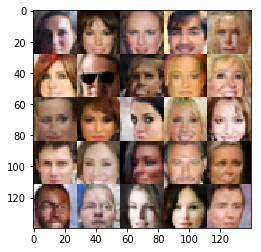

Epoch 10/10 Step 63300... Discriminator Loss: 1.1173... Generator Loss: 0.8654 ... Time spent=0.0887


In [58]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 10

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.